<a href="https://colab.research.google.com/github/dukei/dls-fr/blob/master/DLS-project-FR-1_PrepareDataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face Alignment

## Выбор датасета

В этом проекте мы будем работать с датасетом [CelebA - Original Wild Images](https://www.kaggle.com/datasets/kevinpatel04/celeba-original-wild-images). Обычно, когда говорят про CelebA имеют ввиду его кропнутую и выровненную версию, но мы будем работать с сырой.

![CelebA](https://figures.semanticscholar.org/7df4f96138a4e23492ea96cf921794fc5287ba72/6-Figure4-1.png)

Оригинальная версия датасета весит очень много: ~20 гб. Все картинки нам не будут нужны, достаточно будет ограничиться 10.000+.

Вашим первым заданием будет подготовить себе рабочий датасет. Он будет использован и в следующих заданиях, поэтому подойдите к этому очень ответственно:

- Скачайте себе датасет CelebA In a Wild любым удобным способом;
- Подумайте над тем, по каким критериям лучше всего выбирать картинки. Используйте файл с атрибутами. Обоснуйте свой выбор текстом. В случае, если обоснования выбора датасета не будет, то баллы могут быть снижены. Отнеситесь к этому серьезно: хорошая подготовка данных очень важна;
- Отберите 10.000+ изображений. Можно и больше при желании;
- При помощи атрибутов bbox'а, обрежьте картинки, чтобы на них остались только лица. При желании можно делать дополнительный кроп, так как не везде разметка идеальна, но не нужно сидеть над каждой картинкой отдельно - потратите слишком много времени;
- Сохраните отдельный csv-файл с оригинальными названиями изображений, которые были отобраны в ваш датасет. В дальнейшем он в том числе понадобится для сдачи проекта.

Несколько практических советов:
- Если решили делать дополнительный кроп изображений самостоятельно, то имейте ввиду, что ключевые точки лица в атрибутах указаны в начальной системе координат.
- Не работайте с датасетом в колабе. Простейшую работу с файлами удобнее всего делать локально на своем компьютере. Это не требует мощного железа и скачивания библиотек. Если все же пользуетесь колабом, то работайте на CPU, чтобы не лишний раз не тратить токены.
- Если есть возможность, то не удаляйте оригинальный датасет с вашего компьютера на период работы над проектом. Да, это лишняя занятая память, но зато при надобности можно будет быстро что-то изменить.
- Загрузите финальный датасет (10.000+ картинок) себе на Google Disk. Это удобнее, чем каждый раз отдельно загружать его себе в колаб сессию.

## Подготовка датасета для обучения

## Начинаем!

In [ ]:
!pip install kaggle protobuf

In [ ]:
import os
import kagglehub
import json

dataset_name = 'kevinpatel04/celeba-original-wild-images'
dataset_path = './celeba_dataset/'

source_dir = kagglehub.dataset_download(dataset_name)
source_dir


'/home/dukei/.cache/kagglehub/datasets/kevinpatel04/celeba-original-wild-images/versions/1'

Оказалось, что разметка глаз, носа и рта в этом датасете неправильная, предназначенная для уже выровненных изображений. Зачем вообще эти битые лэндмарки в этом датасете, непонятно. За оригинальными лэндмарками пришлось лезть в оригинальный датасет https://mmlab.ie.cuhk.edu.hk/projects/CelebA.html (хорошо хоть источник указали)

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

Скачиваем разметку из оригинального датасета

In [ ]:
import gdown

if not os.path.exists('celeba_dataset/landmarks.txt'):
    os.makedirs('celeba_dataset', exist_ok=True)

    gdown.download("https://drive.google.com/file/d/0B7EVK8r0v71pTzJIdlJWdHczRlU/view", 'celeba_dataset/landmarks.txt', fuzzy=True)

In [ ]:
bbox_df = pd.read_csv(source_dir + '/list_bbox_celeba.csv')
landmarks_df = pd.read_csv('celeba_dataset/landmarks.txt',
                           sep=' ', skiprows=[0, 1], skipinitialspace=True,
                           names=['image_id','lefteye_x','lefteye_y','righteye_x','righteye_y','nose_x','nose_y','leftmouth_x','leftmouth_y','rightmouth_x','rightmouth_y'])

print("Bounding box data loaded successfully. First 5 rows:")
print(bbox_df.head())
print("\nLandmark data loaded successfully. First 5 rows:")
print(landmarks_df.head())

Bounding box data loaded successfully. First 5 rows:
     image_id  x_1  y_1  width  height
0  000001.jpg   95   71    226     313
1  000002.jpg   72   94    221     306
2  000003.jpg  216   59     91     126
3  000004.jpg  622  257    564     781
4  000005.jpg  236  109    120     166

Landmark data loaded successfully. First 5 rows:
     image_id  lefteye_x  lefteye_y  righteye_x  righteye_y  nose_x  nose_y  \
0  000001.jpg        165        184         244         176     196     249   
1  000002.jpg        140        204         220         204     168     254   
2  000003.jpg        244        104         264         105     263     121   
3  000004.jpg        796        539         984         539     930     687   
4  000005.jpg        273        169         328         161     298     172   

   leftmouth_x  leftmouth_y  rightmouth_x  rightmouth_y  
0          194          271           266           260  
1          146          289           226           289  
2          235

In [ ]:
import os

# Составим список всех файлов датасета

image_files = []
for root, _, files in os.walk(source_dir):
    for file in files:
        if file.endswith('.jpg'):
            image_files.append(os.path.join(root, file))

print(f"Found {len(image_files)} image files.")

Found 202599 image files.


Определим функцию, которая умеет рисовать картинки с разметкой

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os

def plot_image_with_multiple_bboxes(image_path, landmark_data, original_bbox_data, generated_bbox_data=None,
                                    face_quad_vertices=None,
                                    oriented_bbox_corners=None, # Новый параметр для ориентированного BBox
                                    original_bbox_color='yellow', generated_bbox_color='red',
                                    face_quad_color='magenta', face_quad_linestyle=':',
                                    oriented_bbox_color='blue', oriented_bbox_linestyle='-', # Новые параметры для ориентированного BBox
                                    landmark_color='lime', landmark_marker='o'):
    """
    Отображает изображение с опорными точками, исходным ограничивающим прямоугольником,
    сгенерированным ограничивающим прямоугольником, дополнительным четырехугольником лица
    и дополнительным ориентированным ограничивающим прямоугольником.

    :param image_path: Путь к файлу изображения.
    :param landmark_data: Объект pandas Series или словарь, содержащий координаты опорных точек.
    :param original_bbox_data: Объект pandas Series или словарь с 'x_1', 'y_1', 'width', 'height' для исходного BBox.
    :param generated_bbox_data: Кортеж (x_1, y_1, width, height) для сгенерированного BBox.
    :param face_quad_vertices: Список кортежей (x,y), представляющих вершины четырехугольника лица.
    :param oriented_bbox_corners: Список кортежей (x,y), представляющих 4 угла ориентированного BBox.
    :param original_bbox_color: Цвет для исходного ограничивающего прямоугольника.
    :param generated_bbox_color: Цвет для сгенерированного ограничивающего прямоугольника.
    :param face_quad_color: Цвет для четырехугольника лица.
    :param face_quad_linestyle: Стиль линии для четырехугольника лица.
    :param oriented_bbox_color: Цвет для ориентированного ограничивающего прямоугольника.
    :param oriented_bbox_linestyle: Стиль линии для ориентированного ограничивающего прямоугольника.
    :param landmark_color: Цвет для опорных точек.
    :param landmark_marker: Стиль маркера для опорных точек.
    """
    try:
        img = Image.open(image_path)
    except FileNotFoundError:
        print(f"Предупреждение: Изображение не найдено по адресу {image_path}. Пропускаем.")
        return

    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(img)

    # Отображаем опорные точки
    landmark_cols_x = [col for col in landmark_data.index if '_x' in col]
    landmark_cols_y = [col for col in landmark_data.index if '_y' in col]
    landmarks_x = [landmark_data[col] for col in landmark_cols_x]
    landmarks_y = [landmark_data[col] for col in landmark_cols_y]
    ax.scatter(landmarks_x, landmarks_y, color=landmark_color, s=50, marker=landmark_marker, edgecolors='black', linewidths=1.5, label='Landmarks')

    # Отображаем исходный ограничивающий прямоугольник
    orig_x, orig_y, orig_w, orig_h = original_bbox_data['x_1'], original_bbox_data['y_1'], original_bbox_data['width'], original_bbox_data['height']
    original_rect = plt.Rectangle((orig_x, orig_y), orig_w, orig_h, fill=False, edgecolor=original_bbox_color, linewidth=2, label='Original BBox')
    ax.add_patch(original_rect)

    # Отображаем сгенерированный выровненный по осям ограничивающий прямоугольник
    if generated_bbox_data is not None:
        gen_x, gen_y, gen_w, gen_h = generated_bbox_data
        generated_rect = plt.Rectangle((gen_x, gen_y), gen_w, gen_h, fill=False, edgecolor=generated_bbox_color, linewidth=2, label='Generated AABB')
        ax.add_patch(generated_rect)

    # Отображаем четырехугольник лица, если предоставлен
    if face_quad_vertices:
        quad_points_x = [p[0] for p in face_quad_vertices]
        quad_points_y = [p[1] for p in face_quad_vertices]
        # Замыкаем четырехугольник, повторяя первую точку
        ax.plot(quad_points_x + [quad_points_x[0]], quad_points_y + [quad_points_y[0]],
                color=face_quad_color, linewidth=2, linestyle=face_quad_linestyle, label='Face Quadrilateral')

    # Отображаем ориентированный ограничивающий прямоугольник, если предоставлен
    if oriented_bbox_corners is not None:
        # Углы обычно упорядочены [нижний-левый, верхний-левый, верхний-правый, нижний-правый] или аналогично
        # Необходимо замкнуть форму, добавив первую точку снова
        obb_points = np.array(oriented_bbox_corners)
        ax.plot(obb_points[[0,1,2,3,0], 0], obb_points[[0,1,2,3,0], 1],
                color=oriented_bbox_color, linewidth=2, linestyle=oriented_bbox_linestyle, label='Oriented BBox')


    ax.set_title(f"Изображение: {os.path.basename(image_path)}")
    ax.axis('off')
    ax.legend()
    plt.show()


Visualizing 5 random images...


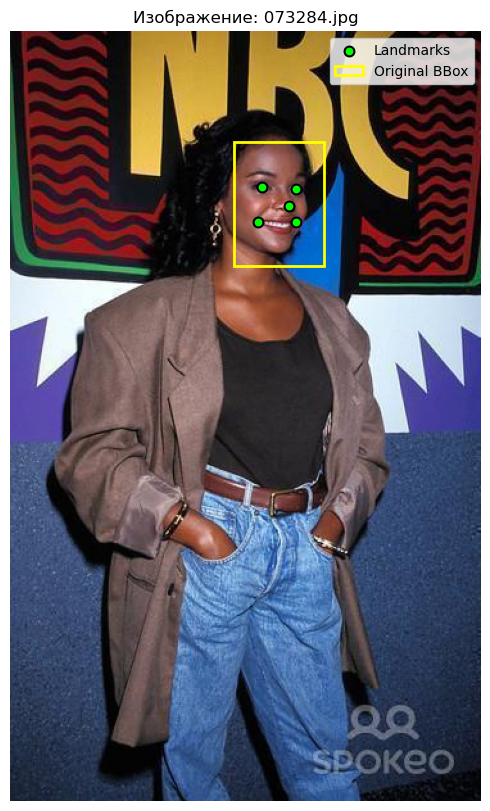

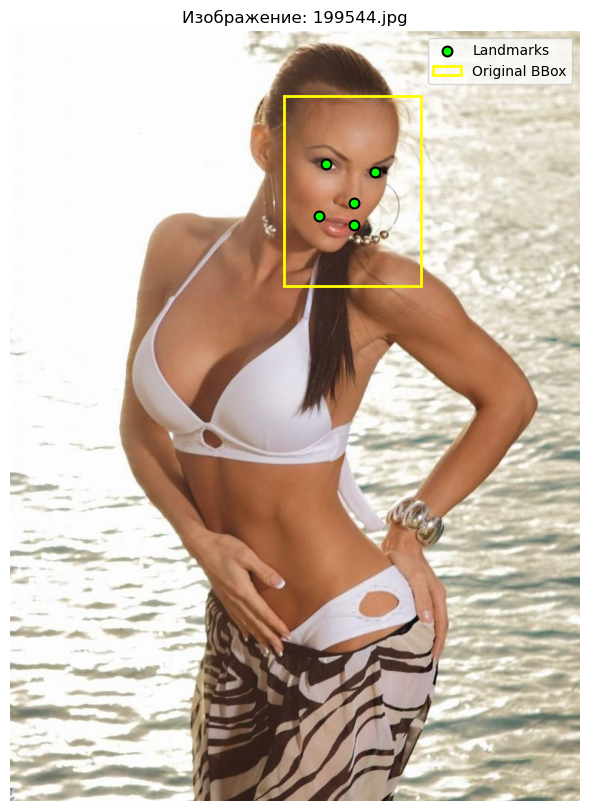

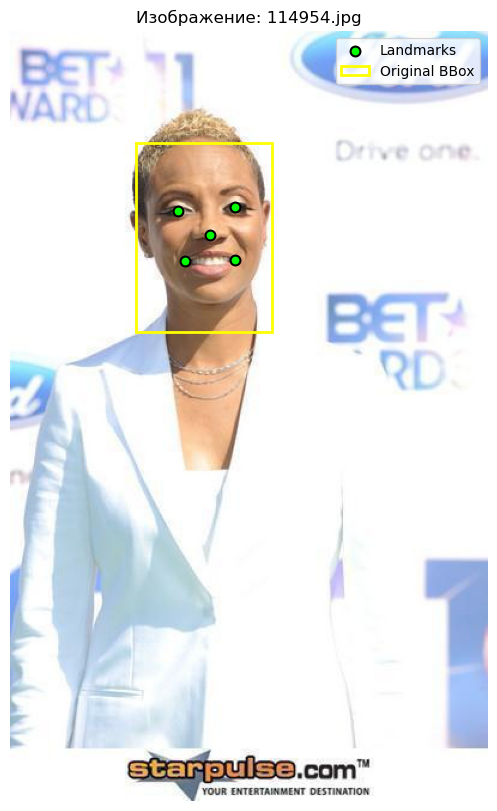

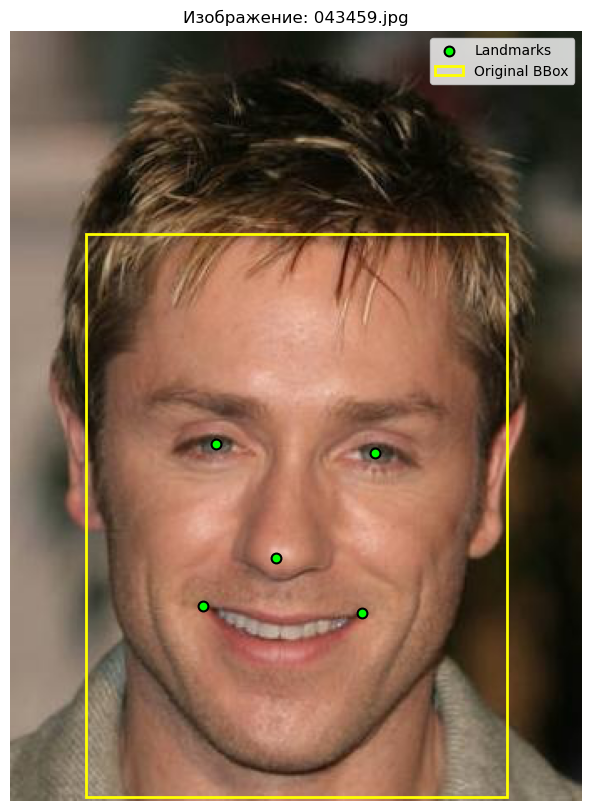

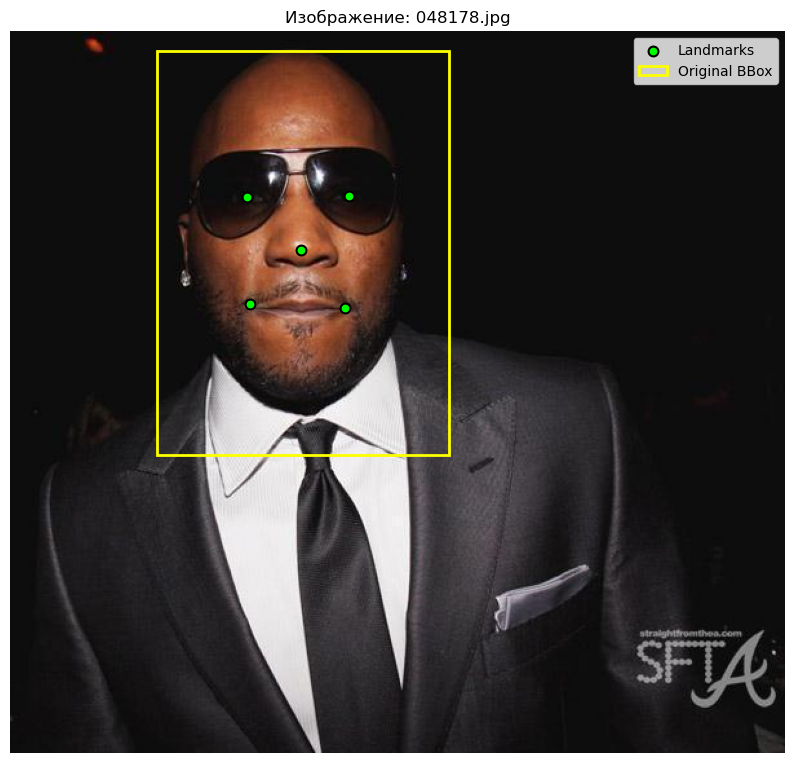

Finished visualizing random images.


In [ ]:
# Визуализируем несколько изображений с рамками и разметкой
np.random.seed(42) # for reproducibility
# Ensure there are enough images to select from
if len(image_files) >= 5:
    random_images = np.random.choice(image_files, 5, replace=False)
else:
    print(f"Warning: Only {len(image_files)} images found. Visualizing all available images.")
    random_images = image_files

if len(random_images) > 0:
    print(f"Visualizing {len(random_images)} random images...")
    for img_file_path in random_images:
        # Extract the image filename (e.g., '000001.jpg') to match with dataframe
        img_filename = os.path.basename(img_file_path)

        # Retrieve bbox and landmarks for the current image
        bbox_row = bbox_df[bbox_df['image_id'] == img_filename]
        landmarks_row = landmarks_df[landmarks_df['image_id'] == img_filename]

        if not bbox_row.empty and not landmarks_row.empty:
            plot_image_with_multiple_bboxes(img_file_path, landmarks_row.iloc[0], bbox_row.iloc[0])
        else:
            print(f"Warning: Bounding box or landmark data not found for {img_filename}. Skipping.")

    print("Finished visualizing random images.")
else:
    print("No images to visualize.")

Рамки действительно не очень. Руками их действительно править не вариант. Но мы же не первые делаем детекцию, поэтому для замены ручного труда можно задетектить рамки какой-нибудь существующей моделью. Воспользуемся, например, https://github.com/exadel-inc/CompreFace

In [ ]:
!pip install urllib3==1.26.6

Модель разворачивается как докер образ и работает по http api. Это, конечно, неоптимально, но нам всего на один раз. Так что сойдет.

In [ ]:
output_csv_path = './celeba_dataset/list_bbox_celeba_compreface.csv'

In [ ]:
if not os.path.exists(output_csv_path):
    from compreface import CompreFace
    from compreface.service import DetectionService
    from compreface.collections import FaceCollection
    from compreface.collections.face_collections import Subjects

    DOMAIN: str = 'http://localhost'
    PORT: str = '8000'
    API_KEY: str = 'd2ae8e5e-b1ac-49e5-bb7c-9d9e596bb5d1'

    compre_face: CompreFace = CompreFace(DOMAIN, PORT)

    detection: DetectionService = compre_face.init_face_detection(API_KEY)

    result = detection.detect(source_dir + '/Part 1/Part 1/000052.jpg', {"limit": 1})

    result



Теперь прогоним через детекцию все изображения датасета, результаты сохраним в новый csv с bbox


In [ ]:
from tqdm.auto import tqdm

if not os.path.exists(output_csv_path):
    all_detected_bboxes = []

    print(f"Starting face detection for {len(image_files)} images...")

    for i, img_file_path in tqdm(enumerate(image_files), total=len(image_files)):
        img_filename = os.path.basename(img_file_path)
        try:
            # Вызываем сервис обнаружения CompreFace
            result = detection.detect(img_file_path, {"limit": 1})

            if result and 'result' in result and len(result['result']) > 0:
                # Извлекаем информацию об ограничивающей рамке для первого обнаруженного лица
                bbox = result['result'][0]['box']
                detected_bbox = {
                    'image_id': img_filename,
                    'x_min': bbox['x_min'],
                    'y_min': bbox['y_min'],
                    'x_max': bbox['x_max'],
                    'y_max': bbox['y_max']
                }
                all_detected_bboxes.append(detected_bbox)
            # else: Лицо не обнаружено, или результат пуст, поэтому мы ничего не добавляем для этого изображения.

            if (i + 1) % 100 == 0: # Печатаем прогресс каждые 100 изображений
                print(f"Processed {i + 1}/{len(image_files)} images. Last processed: {img_filename}")

        except Exception as e:
            print(f"Error processing image {img_filename}: {e}")

    print("Face detection complete.")
    print(f"Found bounding boxes for {len(all_detected_bboxes)} images.")

Starting face detection for 202599 images...


  0%|          | 0/202599 [00:00<?, ?it/s]

Processed 100/202599 images. Last processed: 122170.jpg
Processed 200/202599 images. Last processed: 124158.jpg
Processed 300/202599 images. Last processed: 127161.jpg
Processed 400/202599 images. Last processed: 122774.jpg
Processed 500/202599 images. Last processed: 122815.jpg
Processed 600/202599 images. Last processed: 129227.jpg
Processed 700/202599 images. Last processed: 124120.jpg
Processed 800/202599 images. Last processed: 122968.jpg
Processed 900/202599 images. Last processed: 128178.jpg
Processed 1000/202599 images. Last processed: 128080.jpg
Processed 1100/202599 images. Last processed: 126270.jpg
Processed 1200/202599 images. Last processed: 123801.jpg
Processed 1300/202599 images. Last processed: 128366.jpg
Processed 1400/202599 images. Last processed: 121057.jpg
Processed 1500/202599 images. Last processed: 122448.jpg
Processed 1600/202599 images. Last processed: 128741.jpg
Processed 1700/202599 images. Last processed: 120422.jpg
Processed 1800/202599 images. Last proce

In [ ]:
if not os.path.exists(output_csv_path):
    len(all_detected_bboxes)

200830

In [ ]:
import pandas as pd

if not os.path.exists(output_csv_path):
    # Преобразуем ограничивающие рамки CompreFace в требуемый формат
    formatted_compreface_bboxes = []
    for bbox_data in all_detected_bboxes:
        x_min = bbox_data['x_min']
        y_min = bbox_data['y_min']
        x_max = bbox_data['x_max']
        y_max = bbox_data['y_max']

        x_1 = x_min
        y_1 = y_min
        width = x_max - x_min
        height = y_max - y_min

        formatted_compreface_bboxes.append({
            'image_id': bbox_data['image_id'],
            'x_1': x_1,
            'y_1': y_1,
            'width': width,
            'height': height
        })

    compreface_bbox_df = pd.DataFrame(formatted_compreface_bboxes)

    print("Ограничивающие рамки CompreFace преобразованы и сохранены в 'compreface_bbox_df'. Первые 5 строк:")
    print(compreface_bbox_df.head())
    print(f"Общее количество обнаруженных рамок CompreFace: {len(compreface_bbox_df)}")

Ограничивающие рамки CompreFace преобразованы и сохранены в 'compreface_bbox_df'. Первые 5 строк:
     image_id  x_1  y_1  width  height
0  125988.jpg   58   11    120     142
1  121488.jpg   64  105    217     228
2  126614.jpg   23   94    285     292
3  126917.jpg  101   93    130     128
4  120809.jpg  102   46    147     181
Общее количество обнаруженных рамок CompreFace: 200830


In [ ]:
if not os.path.exists(output_csv_path):
    compreface_bbox_df.to_csv(output_csv_path, index=False)
    print(f"CompreFace bounding boxes saved to {output_csv_path}")
else:
    compreface_bbox_df = pd.read_csv(output_csv_path)

Не на всех картинках найдены лица. Видимо, CompreFace - модель не самая умная. Посмотрим сначала, какие рамки она сделала

Visualizing 5 random images...


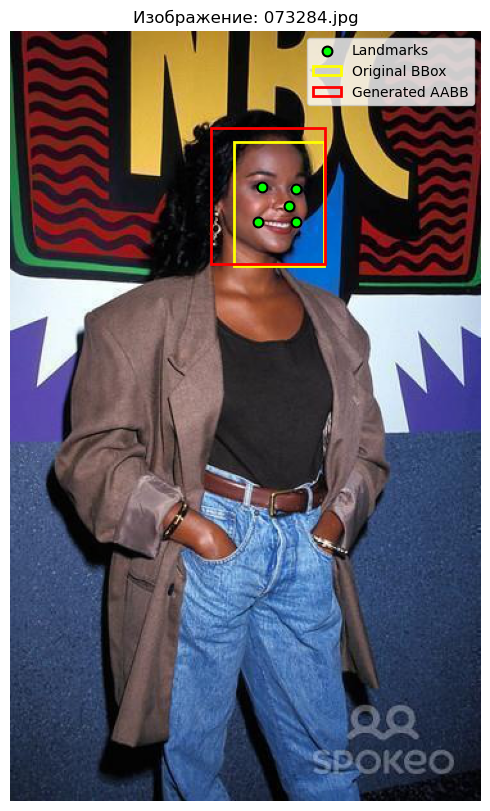

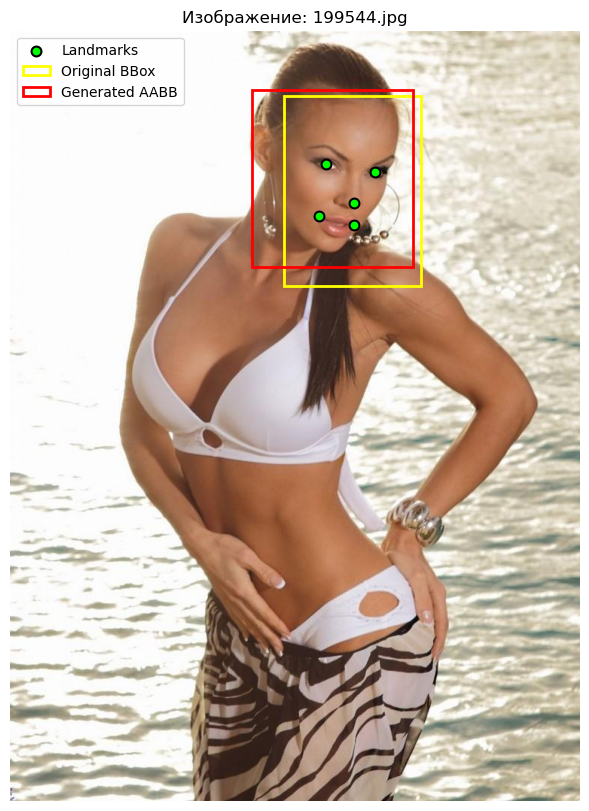

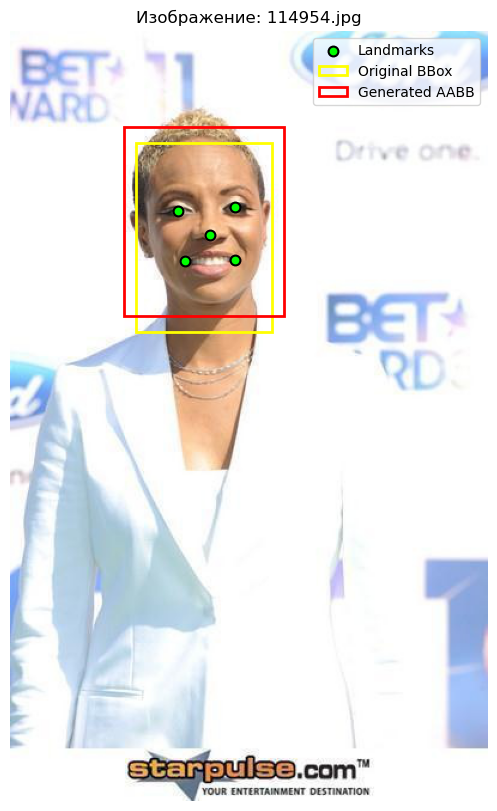

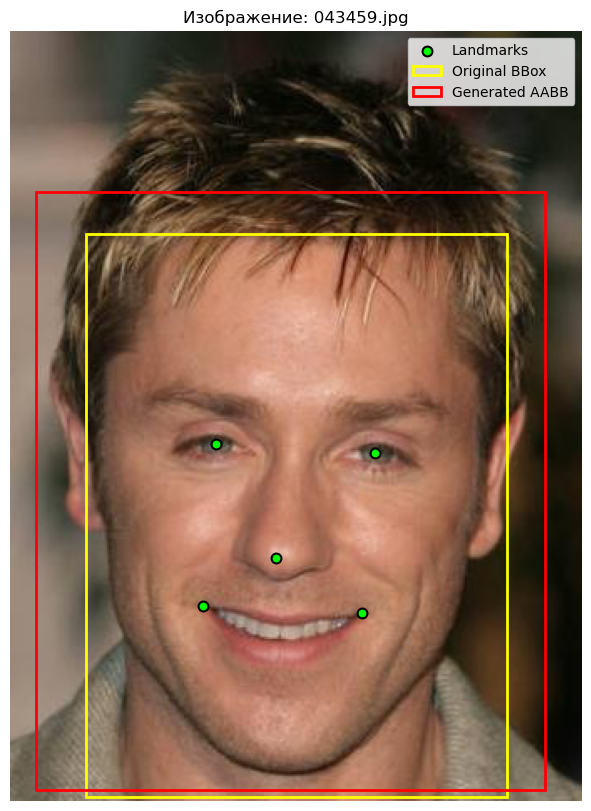

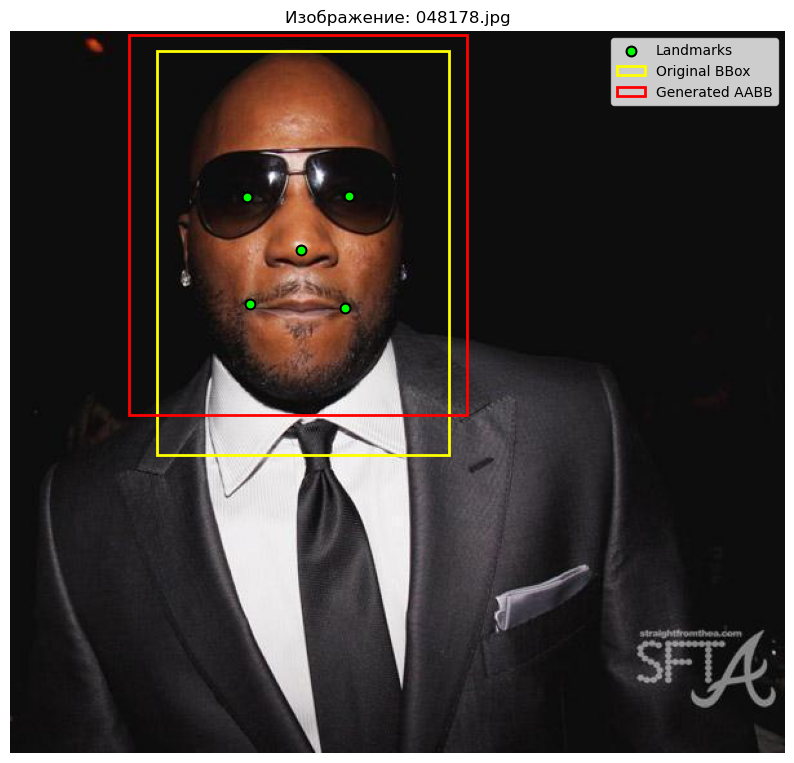

Finished visualizing random images.


In [ ]:
# Визуализируем несколько изображений с рамками и разметкой
np.random.seed(42) # for reproducibility
# Ensure there are enough images to select from
if len(image_files) >= 5:
    random_images = np.random.choice(image_files, 5, replace=False)
else:
    print(f"Warning: Only {len(image_files)} images found. Visualizing all available images.")
    random_images = image_files

if len(random_images) > 0:
    print(f"Visualizing {len(random_images)} random images...")
    for img_file_path in random_images:
        # Extract the image filename (e.g., '000001.jpg') to match with dataframe
        img_filename = os.path.basename(img_file_path)

        # Retrieve landmarks for the current image
        landmarks_row = landmarks_df[landmarks_df['image_id'] == img_filename]

        # Retrieve CompreFace bbox for the current image
        compreface_bbox_row = compreface_bbox_df[compreface_bbox_df['image_id'] == img_filename]
        bbox_row = bbox_df[bbox_df['image_id'] == img_filename]

        # Check if both landmarks and CompreFace bbox are available
        if not compreface_bbox_row.empty and not landmarks_row.empty:
            try:
                img = Image.open(img_file_path)
                image_width, image_height = img.size
            except FileNotFoundError:
                print(f"Warning: Image not found at {img_file_path}. Skipping visualization.")
                continue

            # Extract the individual bbox components from the DataFrame row
            gen_x = compreface_bbox_row.iloc[0]['x_1']
            gen_y = compreface_bbox_row.iloc[0]['y_1']
            gen_w = compreface_bbox_row.iloc[0]['width']
            gen_h = compreface_bbox_row.iloc[0]['height']

            plot_image_with_multiple_bboxes(
                img_file_path,
                landmarks_row.iloc[0],
                bbox_row.iloc[0], #original bbox (yellow)
                generated_bbox_data=(gen_x, gen_y, gen_w, gen_h) # CompreFace bbox (red)
            )
        else:
            print(f"Warning: CompreFace bounding box or landmark data not found for {img_filename}. Skipping.")

    print("Finished visualizing random images.")
else:
    print("No images to visualize.")

Сделанные моделью рамки лучше присутствующих в датасете. Лучше будем пользоваться ими.

А теперь разберемся с изображениями, на которых модель лиц не нашла.

In [ ]:
def path_by_image_name(image_name):
    for full_path in image_files:
        if os.path.basename(full_path) == image_name:
            return full_path


Составим список изображений "без лиц" и посмотрим несколько примеров

Всего обработано изображений: 202599
Изображений с обнаруженными ограничивающими рамками: 200830
Изображений без обнаруженных ограничивающих рамок: 1769
Отображение нескольких случайных изображений без обнаруженных ограничивающих рамок...


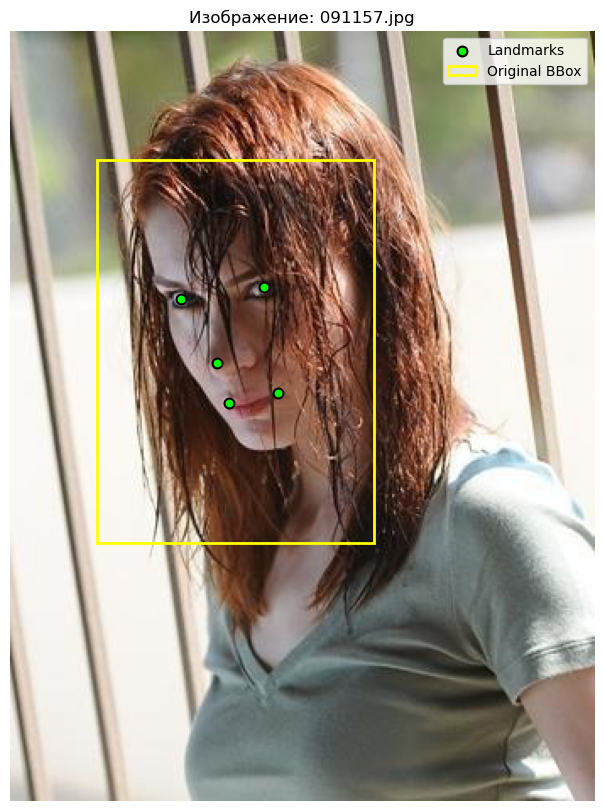

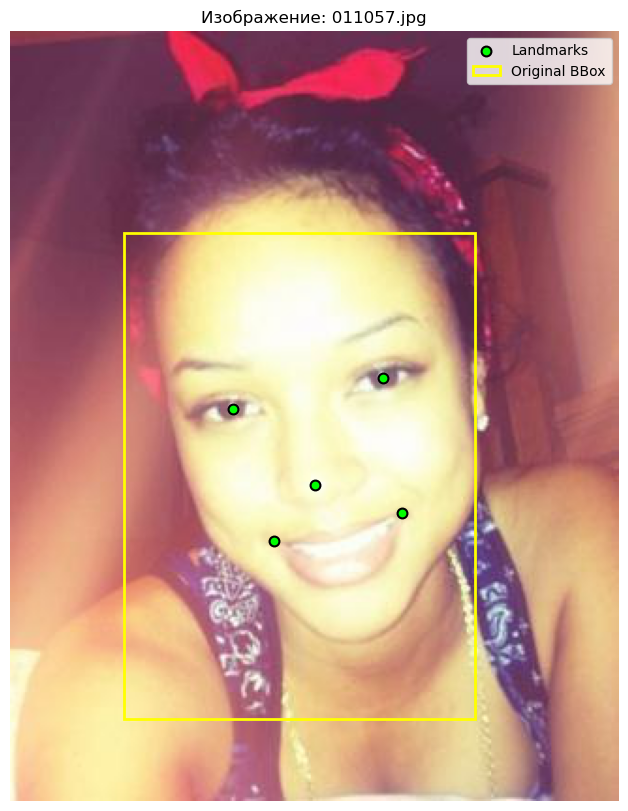

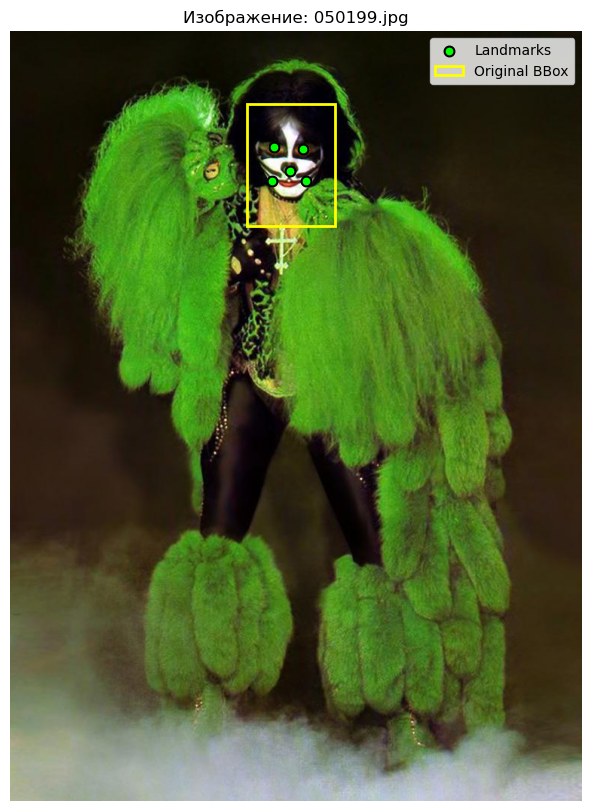

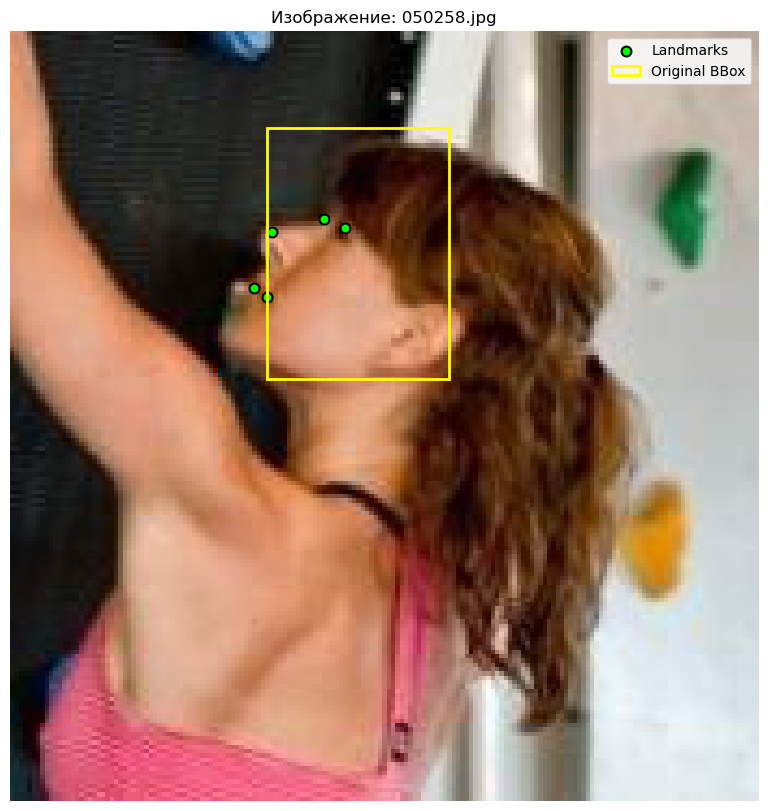

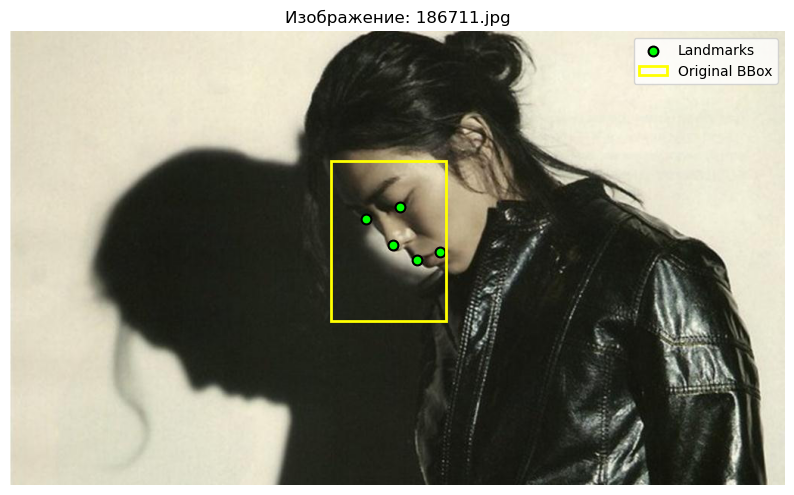

In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np

# Получаем список image_id, для которых были обнаружены ограничивающие рамки
detected_image_ids = set(compreface_bbox_df['image_id'])

# Получаем список всех оригинальных имен файлов изображений
all_image_filenames = {os.path.basename(f) for f in image_files}

# Находим image_id, для которых не было обнаружено ограничивающих рамок
images_without_bbox_filenames = list(all_image_filenames - detected_image_ids)

print(f"Всего обработано изображений: {len(all_image_filenames)}")
print(f"Изображений с обнаруженными ограничивающими рамками: {len(detected_image_ids)}")
print(f"Изображений без обнаруженных ограничивающих рамок: {len(images_without_bbox_filenames)}")

if len(images_without_bbox_filenames) > 0:
    print("Отображение нескольких случайных изображений без обнаруженных ограничивающих рамок...")
    # Выбираем до 5 случайных изображений без bbox
    np.random.seed(42) # for reproducibility
    num_to_display = min(5, len(images_without_bbox_filenames))
    random_no_bbox_filenames = np.random.choice(images_without_bbox_filenames, num_to_display, replace=False)

    # Сопоставляем имена файлов с полными путями (предполагая оригинальную структуру)
    # Для простоты, мы будем перебирать image_files, чтобы найти полные пути
    full_paths_no_bbox = []
    for filename in random_no_bbox_filenames:
        for full_path in image_files:
            if os.path.basename(full_path) == filename:
                full_paths_no_bbox.append(full_path)
                break

    for img_path in full_paths_no_bbox:
        img_filename = os.path.basename(img_path)

        # Получаем данные оригинального bbox и ориентиров для текущего изображения
        bbox_row = bbox_df[bbox_df['image_id'] == img_filename]
        landmarks_row = landmarks_df[landmarks_df['image_id'] == img_filename]

        if not bbox_row.empty and not landmarks_row.empty:
            try:
                plot_image_with_multiple_bboxes(img_path, landmarks_row.iloc[0], bbox_row.iloc[0])
            except FileNotFoundError:
                print(f"Предупреждение: Изображение не найдено по адресу {img_path}. Пропускаем отображение.")
            except Exception as e:
                print(f"Ошибка отображения изображения {img_path}: {e}")
        else:
            print(f"Предупреждение: Данные ограничивающей рамки или ориентиров не найдены для {img_filename}. Пропускаем отображение.")

else:
    print("Все изображения имели хотя бы одно обнаруженное лицо или список был пуст.")

In [ ]:

image_path = path_by_image_name('091157.jpg');
result = detection.detect(image_path, {"limit": 1})
result

{'message': 'No face is found in the given image', 'code': 28}

Похоже, все изображения всё же с лицами. Но модель эти лица в упор не находит. Можно, конечно, их удалить, но жалко. Использовать оригинальные рамки тоже не хочется, они какие-то все смещенные. Но при этом разметка частей лица хорошая. Можно попробовать восстановить рамки из разметки.

## Функция для генерации ограничивающих рамок на основе ключевых точек

### Задача:
Оригинальные рамки очень плохие, некоторые даже не вмещают в себя лэндмарки. Однако сами лэндмарки, похоже, проставлены точно. Поэтому можем попытаться вычислить новые рамки на основе лэндмарков.

Создадим функцию `generate_bbox_from_landmarks`, которая по координатам ключевых точек лица определяет ограничивающую рамку. Эта функция будет использовать эвристические правила для различения анфаса и профиля, а затем генерировать соответствующий четырехсторонний полигон лица, из которого вычисляется итоговая ось-выровненная ограничивающая рамка (AABB).

### Эвристика:

1.  **Определение типа лица (анфас или профиль)**:
    *   Мы сначала формируем воображаемый четырехугольник, соединяющий ключевые точки глаз и уголков рта.
    *   Если точка носа находится *внутри* этого четырехугольника, лицо считается **анфасом**.
    *   Если точка носа находится *вне* этого четырехугольника, лицо считается **профилем**.

2.  **Генерация полигона лица для анфаса**:
    *   Для анфаса четырехугольник лица создается как расширенная версия четырехугольника глаз-рот в соответствии со стандартными пропорциями головы по Ломбардо.
    *   **Верхняя граница (линия головы)**: Проводится параллельно линии глаз и отступает от нее (в сторону, противоположную рту) на расстояние, равное 1.5 раза средней вертикальной дистанции между линией глаз и линией рта.
    *   **Нижняя граница (линия подбородка)**: Проводится параллельно линии рта и отступает от нее (в сторону, противоположную глазам) на расстояние, равное 0.5 раза средней вертикальной дистанции между линией глаз и линией рта.
    *   **Ширина**: Горизонтальные размеры нового четырехугольника пропорционально увеличиваются, основываясь на ширине линии глаз и линии рта.
    *   **Смещение**: Если положение носа указывает на легкое смещение от чистого анфаса (т.е. приближается к профилю), весь четырехугольник лица немного сдвигается в сторону носа, чтобы лучше охватить лицо.

3.  **Генерация полигона лица для профиля**:
    *   Для профильного лица генерируется **прямоугольный** полигон.
    *   **"Длина носа"**: Определяется как перпендикулярное расстояние от ключевой точки носа до средней линии, соединяющей центры глаз и рта.
    *   **Размеры прямоугольника**:
        *   Сторона, параллельная средней линии глаз-рот (условно "высота" лица): будет примерно в 3 раза длиннее расстояния между центром глаз и центром рта.
        *   Сторона, перпендикулярная средней линии глаз-рот (условно "ширина" лица): будет примерно в 7 раз длиннее "длины носа".
    *   Этот прямоугольник будет ориентирован в пространстве, следуя ориентации лица.

4.  **Итоговая ось-выровненная ограничивающая рамка (AABB)**:
    *   После того как четырехсторонний полигон лица (для анфаса) или прямоугольник (для профиля) построен, мы вычисляем минимальный ось-выровненный ограничивающий прямоугольник (AABB), который полностью включает этот полигон. Это гарантирует, что итоговая ограничивающая рамка всегда будет выровнена по осям изображения, даже если сгенерированный полигон лица имеет наклон.
    *   Наконец, все координаты ограничивающей рамки обрезаются, чтобы они находились в пределах размеров исходного изображения.

In [ ]:
import numpy as np
import cv2

def distance(p1, p2):
    # Вычисляет евклидово расстояние между двумя точками
    return np.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)

def midpoint(p1, p2):
    # Вычисляет середину отрезка между двумя точками
    return ((p1[0] + p2[0]) / 2, (p1[1] + p2[1]) / 2)

def line_equation(p1, p2):
    # Возвращает A, B, C для уравнения прямой Ax + By + C = 0
    if p1[0] == p2[0]: # Вертикальная линия
        return 1, 0, -p1[0]
    elif p1[1] == p2[1]: # Горизонтальная линия
        return 0, 1, -p1[1]
    else:
        A = p2[1] - p1[1]
        B = p1[0] - p2[0]
        C = -A * p1[0] - B * p1[1]
        return A, B, C

def point_line_distance(point, A, B, C):
    # Расстояние от точки (x0, y0) до прямой Ax + By + C = 0
    x0, y0 = point
    return abs(A * x0 + B * y0 + C) / np.sqrt(A**2 + B**2)

def is_point_inside_quadrilateral(point, quad_points):
    # quad_points упорядочены (например, верхний-левый, верхний-правый, нижний-правый, нижний-левый)
    # Использует алгоритм отсечения лучами или проверку, находится ли точка на одной стороне всех линий
    # Для простоты, сначала используем проверку ограничивающего прямоугольника, затем более сложную при необходимости.
    # Для выпуклого четырехугольника проверьте, находится ли точка на одной стороне всех ребер.

    # Проверяет, находится ли точка на левой стороне направленного отрезка (p1, p2)
    def is_left(p1, p2, p):
        return ((p2[0] - p1[0]) * (p[1] - p1[1])) - ((p2[1] - p1[1]) * (p[0] - p1[0]))

    # Итерация по ребрам и проверка на согласованную ориентацию
    num_vertices = len(quad_points)
    wn = 0  # Число оборотов
    for i in range(num_vertices):
        p1 = quad_points[i]
        p2 = quad_points[(i + 1) % num_vertices]
        if p1[1] <= point[1]:
            if p2[1] > point[1] and is_left(p1, p2, point) > 0:
                wn += 1
        elif p2[1] <= point[1] and is_left(p1, p2, point) < 0:
            wn -= 1
    return wn != 0

def calculate_aabb(points):
    # Вычисляет ось-выровненный ограничивающий прямоугольник (AABB) для набора точек
    x_coords = [p[0] for p in points]
    y_coords = [p[1] for p in points]
    min_x = int(min(x_coords))
    max_x = int(max(x_coords))
    min_y = int(min(y_coords))
    max_y = int(max(y_coords))
    return (min_x, min_y, max_x - min_x, max_y - min_y)

def generate_bbox_from_landmarks(landmark_data, image_width, image_height):
    """
    Генерирует ось-выровненный ограничивающий прямоугольник (x_1, y_1, width, height)
    из координат опорных точек, применяя пропорциональное заполнение и
    различая фронтальные и профильные лица.

    :param landmark_data: Объект pandas Series или словарь, содержащий координаты опорных точек.
    :param image_width: Ширина исходного изображения.
    :param image_height: Высота исходного изображения.
    :return: Кортеж (bbox_tuple, face_quad_vertices_list, oriented_bbox_corners), представляющий
             ограничивающий прямоугольник, список вершин четырехугольника лица и вершины ориентированного BBox.
    """
    lefteye = (landmark_data['lefteye_x'], landmark_data['lefteye_y'])
    righteye = (landmark_data['righteye_x'], landmark_data['righteye_y'])
    nose = (landmark_data['nose_x'], landmark_data['nose_y'])
    leftmouth = (landmark_data['leftmouth_x'], landmark_data['leftmouth_y'])
    rightmouth = (landmark_data['rightmouth_x'], landmark_data['rightmouth_y'])

    # Четырехугольник из глаз и уголков рта (упорядочен как верхний-левый, верхний-правый, нижний-правый, нижний-левый для проверки выпуклости)
    eye_mouth_quad = [
        lefteye,
        righteye,
        rightmouth,
        leftmouth
    ]

    # Определяем, является ли лицо фронтальным или профильным
    # Нос находится 'внутри' четырехугольника глаз-рот, если это фронтальное лицо
    is_frontal = is_point_inside_quadrilateral(nose, eye_mouth_quad)

    face_quad_vertices = []
    generated_bbox = None
    oriented_bbox_corners = None # Инициализируем для ориентированного ограничивающего прямоугольника

    if is_frontal:
        # Логика для фронтального лица
        eye_center = np.array(midpoint(lefteye, righteye))
        mouth_center = np.array(midpoint(leftmouth, rightmouth))
        nose_arr = np.array(nose)

        # Направление средне-вертикальной оси (от центра глаза к центру рта)
        mid_vertical_vec = mouth_center - eye_center
        mid_vertical_len = np.linalg.norm(mid_vertical_vec)
        mid_vertical_unit = mid_vertical_vec / mid_vertical_len if mid_vertical_len > 0 else np.array([0., 1.])

        # Направление горизонтальной оси (перпендикулярно mid_vertical_unit, направлено вправо от лица)
        horizontal_unit = np.array([mid_vertical_unit[1], -mid_vertical_unit[0]])

        # Вычисляем опорную центральную точку области глаз-рот
        face_central_point = (eye_center + mouth_center) / 2

        # Вычисляем вектор от face_central_point до носа
        nose_relative_to_center_vec = nose_arr - face_central_point

        # Проектируем этот вектор на горизонтальную ось, чтобы получить компонент бокового смещения
        lateral_shift_magnitude = np.dot(nose_relative_to_center_vec, horizontal_unit)

        # Применяем это боковое смещение (смещение на -X)
        lateral_shift_vector = -lateral_shift_magnitude * horizontal_unit

        # Существующие расчеты для new_top_mid и new_bottom_mid, теперь с учетом бокового смещения
        new_top_mid = eye_center - (1.5 * mid_vertical_len) * mid_vertical_unit + lateral_shift_vector
        new_bottom_mid = mouth_center + (0.65 * mid_vertical_len) * mid_vertical_unit + lateral_shift_vector

        # Существующие расчеты для линии глаз и линии рта
        eye_line_vec = np.array(righteye) - np.array(lefteye)
        eye_line_dir_unit = eye_line_vec / np.linalg.norm(eye_line_vec) if np.linalg.norm(eye_line_vec) > 0 else horizontal_unit
        eye_line_length = np.linalg.norm(eye_line_vec)

        mouth_line_vec = np.array(rightmouth) - np.array(leftmouth)
        mouth_line_dir_unit = mouth_line_vec / np.linalg.norm(mouth_line_vec) if np.linalg.norm(mouth_line_vec) > 0 else horizontal_unit
        mouth_line_length = np.linalg.norm(mouth_line_vec)

        # Ширина для нового четырехугольника
        top_half_width = (eye_line_length * 3) / 2
        bottom_half_width = (mouth_line_length * 3) / 2

        # Вершины нового четырехугольника лица
        p1 = new_top_mid - top_half_width * eye_line_dir_unit
        p2 = new_top_mid + top_half_width * eye_line_dir_unit
        p3 = new_bottom_mid + bottom_half_width * mouth_line_dir_unit
        p4 = new_bottom_mid - bottom_half_width * mouth_line_dir_unit

        face_quad_vertices = [tuple(p1), tuple(p2), tuple(p3), tuple(p4)]
        generated_bbox = calculate_aabb(face_quad_vertices)

        # Вычисляем ориентированный минимальный ограничивающий прямоугольник (OMBB) для фронтальных лиц
        if len(face_quad_vertices) >= 3: # minAreaRect требует минимум 3 точки
            face_quad_np = np.array(face_quad_vertices, dtype=np.float32)
            rect = cv2.minAreaRect(face_quad_np)
            oriented_bbox_corners = cv2.boxPoints(rect)
            oriented_bbox_corners = np.int32(oriented_bbox_corners).tolist() # Преобразуем в список кортежей целых чисел

    else:
        # Логика для профильного лица
        eye_mid = np.array(midpoint(lefteye, righteye))
        mouth_mid = np.array(midpoint(leftmouth, rightmouth))
        nose_arr = np.array(nose)

        # Средняя линия четырехугольника глаз-рот
        midline_p1 = eye_mid
        midline_p2 = mouth_mid

        # Вектор вдоль средней линии глаз-рот и ее длина (X)
        midline_vec = midline_p2 - midline_p1
        midline_len_X = np.linalg.norm(midline_vec)
        # Предотвращаем деление на ноль, если точки совпадают
        midline_vec_unit = midline_vec / midline_len_X if midline_len_X > 0 else np.array([0., 1.])

        # Определяем, куда смотрит профиль, чтобы правильно сориентировать перпендикулярный вектор
        A_midline, B_midline, C_midline = line_equation(tuple(midline_p1), tuple(midline_p2))
        nose_len = point_line_distance(tuple(nose_arr), A_midline, B_midline, C_midline)

        test_point = nose_arr
        # Определяем, с какой стороны нос находится от средней линии
        side_check = (midline_p2[0] - midline_p1[0]) * (test_point[1] - midline_p1[1]) - \
                     (midline_p2[1] - midline_p1[1]) * (test_point[0] - midline_p1[0])

        if side_check > 0: # Нос находится 'слева' от направленной линии midline_p1 -> midline_p2
            perp_direction_unit = np.array([-midline_vec_unit[1], midline_vec_unit[0]]) # Направлен 'влево'
        else:
            perp_direction_unit = np.array([midline_vec_unit[1], -midline_vec_unit[0]]) # Направлен 'вправо'

        # Размеры прямоугольника
        rect_width = 7 * nose_len
        rect_height = 3.15 * midline_len_X # (1.5X + X + 0.65X) - общая длина вдоль midline_vec_unit
        rect_padding = 0.2 * nose_len

        half_rect_width = rect_width / 2
        half_rect_height = rect_height / 2

        # Точки, определяющие края прямоугольника согласно инструкциям
        # Точка на верхней границе: eye_mid - 1.5 * X * midline_vec_unit
        # Точка на нижней границе: mouth_mid + 0.65 * X * midline_vec_unit
        # Точка на передней границе (со стороны носа): nose + nose_len * perp_direction_unit
        # Точка на задней границе: nose + (nose_len - rect_width) * perp_direction_unit

        val_top_edge_along_midline = np.dot(eye_mid, midline_vec_unit) - 1.5 * midline_len_X
        val_bottom_edge_along_midline = np.dot(mouth_mid, midline_vec_unit) + 0.65 * midline_len_X

        val_front_edge_along_perp = np.dot(nose_arr, perp_direction_unit) + rect_padding
        val_back_edge_along_perp = np.dot(nose_arr, perp_direction_unit) + (rect_padding - rect_width)

        # Вершины прямоугольника
        # v1: Top-Back
        v1 = val_top_edge_along_midline * midline_vec_unit + val_back_edge_along_perp * perp_direction_unit
        # v2: Top-Front
        v2 = val_top_edge_along_midline * midline_vec_unit + val_front_edge_along_perp * perp_direction_unit
        # v3: Bottom-Front
        v3 = val_bottom_edge_along_midline * midline_vec_unit + val_front_edge_along_perp * perp_direction_unit
        # v4: Bottom-Back
        v4 = val_bottom_edge_along_midline * midline_vec_unit + val_back_edge_along_perp * perp_direction_unit

        face_quad_vertices = [tuple(v1), tuple(v2), tuple(v3), tuple(v4)]
        generated_bbox = calculate_aabb(face_quad_vertices)


    # Логика отката должна быть удалена или доработана. Если логика для фронтального и профильного распознавания надежна,
    # generated_bbox всегда будет установлен. Я сделаю откат явным, чтобы избежать случайных None.
    if generated_bbox is None or not face_quad_vertices: # Проверяем face_quad_vertices, если OMBB должен быть рассчитан
        # Это означает, что что-то пошло не так как с логикой фронтального, так и с логикой профильного распознавания
        # или, например, деление на ноль, если норма равна нулю (что очень маловероятно с опорными точками).
        # Откат к простому AABB вокруг всех опорных точек с отступами
        x_coords = [lefteye[0], righteye[0], nose[0], leftmouth[0], rightmouth[0]]
        y_coords = [lefteye[1], righteye[1], nose[1], leftmouth[1], rightmouth[1]]

        min_x = min(x_coords)
        max_x = max(x_coords)
        min_y = min(y_coords)
        max_y = max(y_coords)

        initial_width = max_x - min_x
        initial_height = max_y - min_y

        padding_ratio = 0.2 # Заполнение по умолчанию из исходной функции
        pad_x = initial_width * padding_ratio
        pad_y = initial_height * padding_ratio

        x_1 = max(0, int(min_x - pad_x))
        y_1 = max(0, int(min_y - pad_y))
        width = int(initial_width + 2 * pad_x)
        height = int(initial_height + 2 * pad_y)

        generated_bbox = (x_1, y_1, width, height)
        face_quad_vertices = None # Нет конкретного четырехугольника для этого общего отката
        oriented_bbox_corners = None # Нет ориентированного ограничивающего прямоугольника для отката

    # Окончательное обрезание для обеспечения того, чтобы ограничивающий прямоугольник оставался в пределах изображения
    if generated_bbox is not None:
        x_1, y_1, width, height = generated_bbox

        # Вычисляем координаты нижнего правого угла
        x_2 = x_1 + width
        y_2 = y_1 + height

        # Обрезаем координаты верхнего левого угла, чтобы они были неотрицательными
        x_1_clipped = max(0, x_1)
        y_1_clipped = max(0, y_1)

        # Обрезаем координаты нижнего правого угла, чтобы они находились в пределах image_width/image_height
        x_2_clipped = min(image_width, x_2)
        y_2_clipped = min(image_height, y_2)

        # Пересчитываем ширину и высоту на основе обрезанных координат
        final_width = x_2_clipped - x_1_clipped
        final_height = y_2_clipped - y_1_clipped

        # Убеждаемся, что ширина и высота неотрицательны (может произойти, если x_1_clipped >= x_2_clipped)
        final_width = max(0, final_width)
        final_height = max(0, final_height)

        generated_bbox = (x_1_clipped, y_1_clipped, final_width, final_height)

    return generated_bbox, face_quad_vertices, oriented_bbox_corners


Теперь попробуем, как работает наше вычисление рамок, сравним их с изначальными. Наши рамки красные, изначальные - желтые. Пунктирные и синие рамки - промежуточные результаты.

Визуализация изображений, где CompreFace не смог обнаружить лица, сравнение оригинальных, сгенерированных на основе ориентиров и ориентированных ограничивающих рамок...


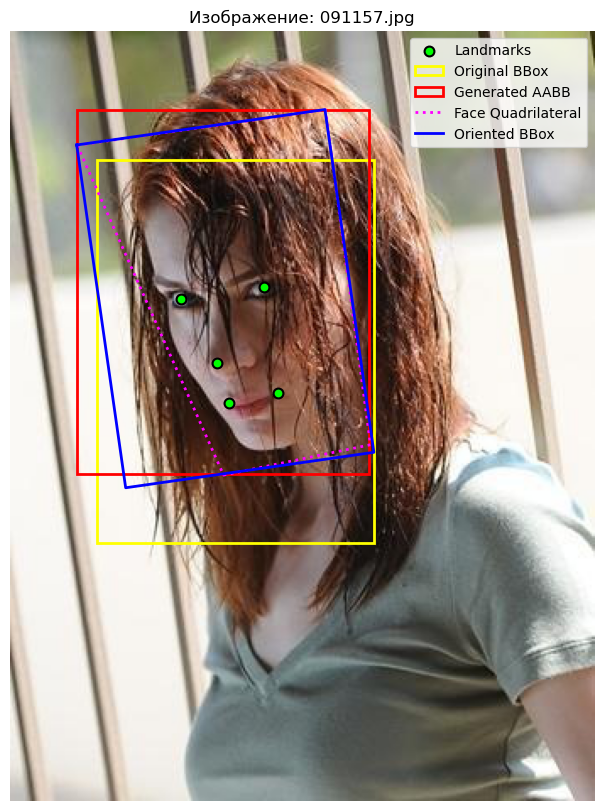

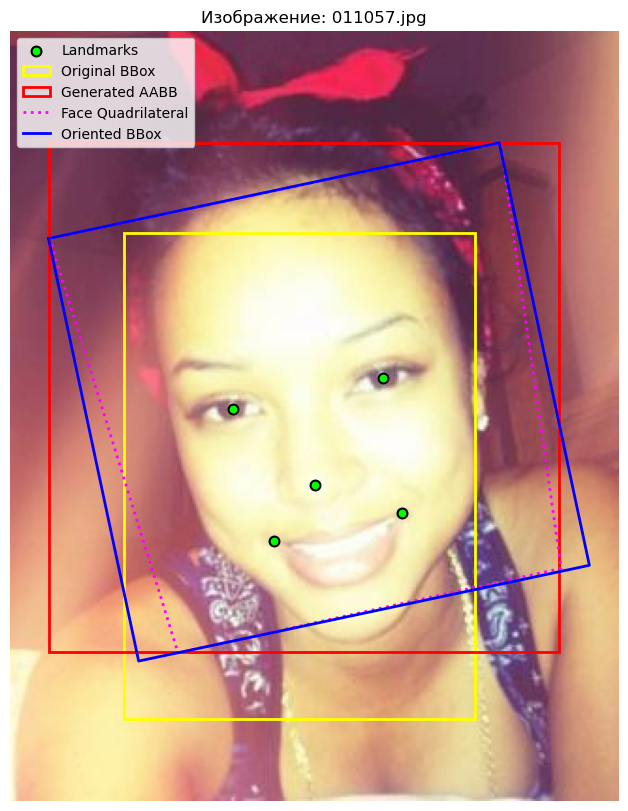

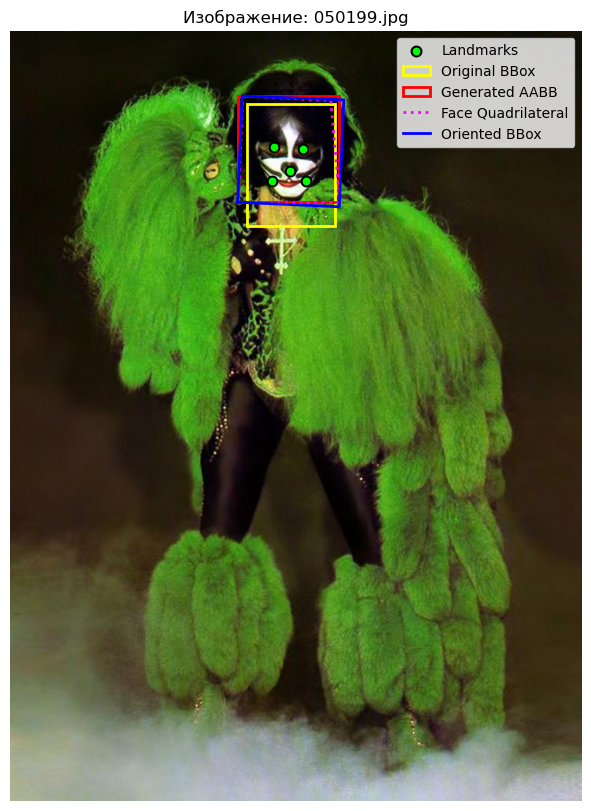

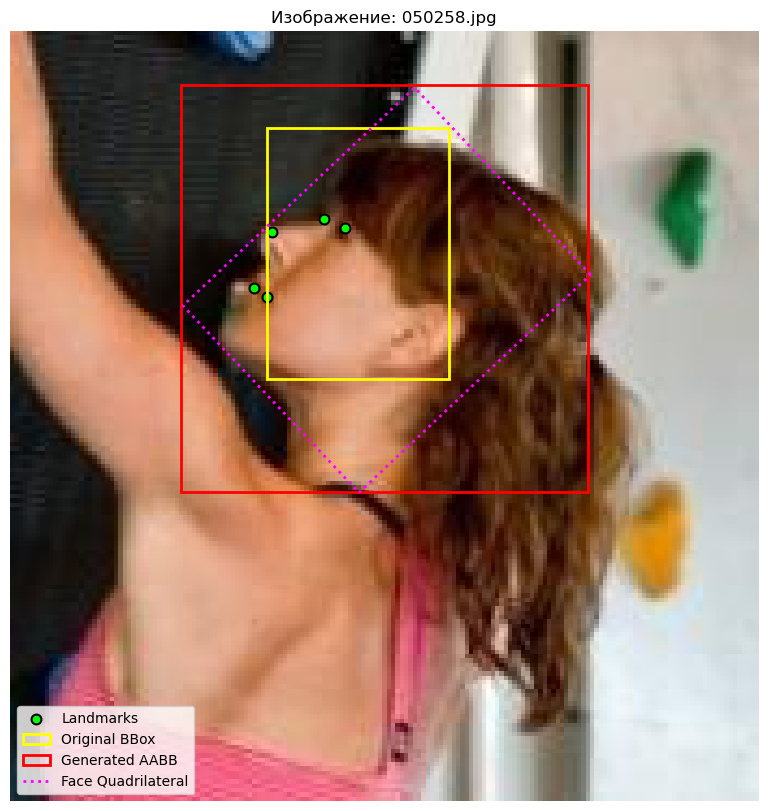

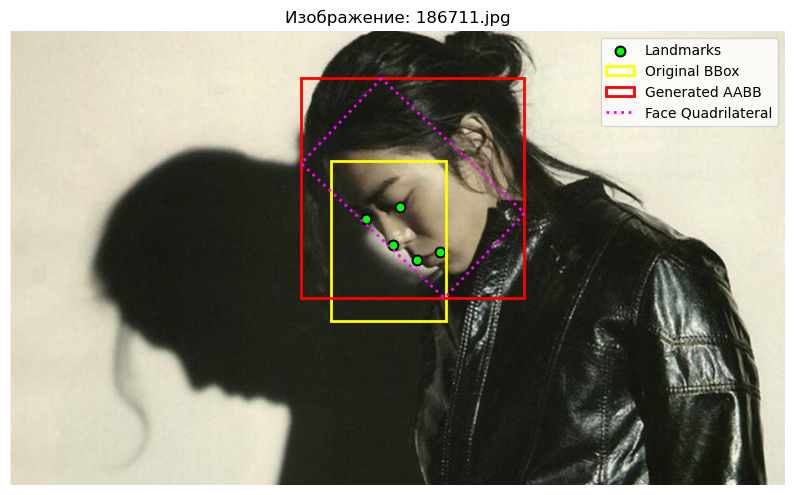

...

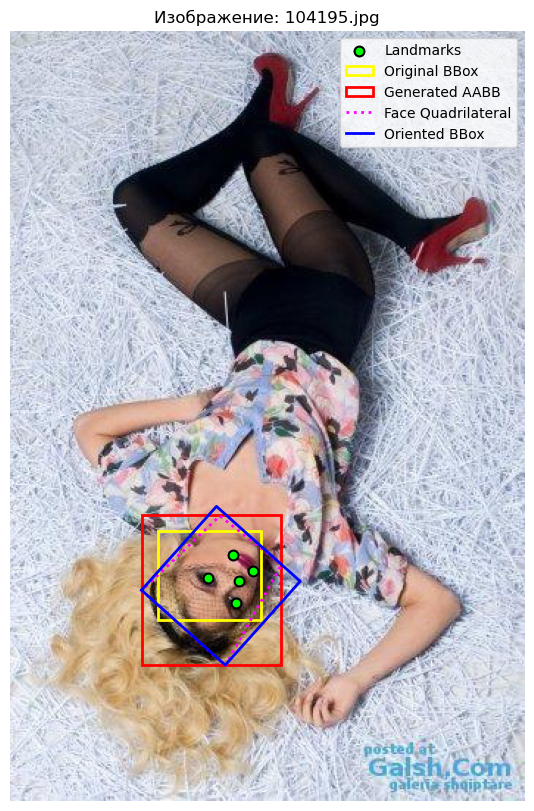

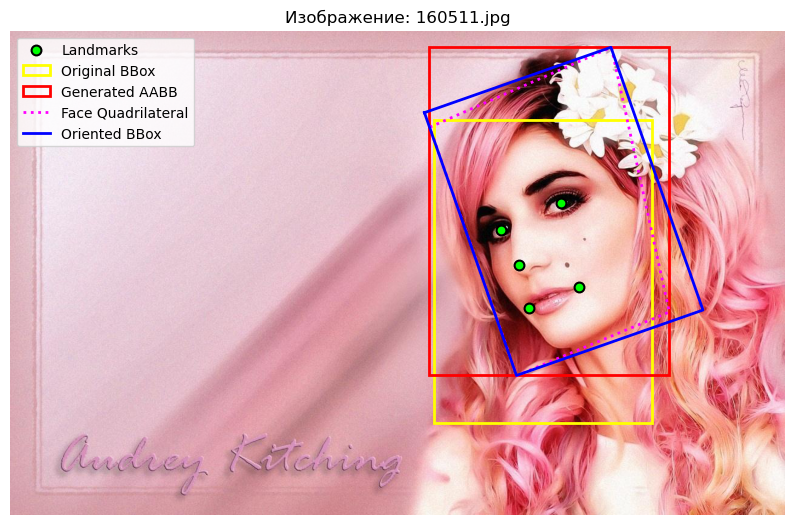

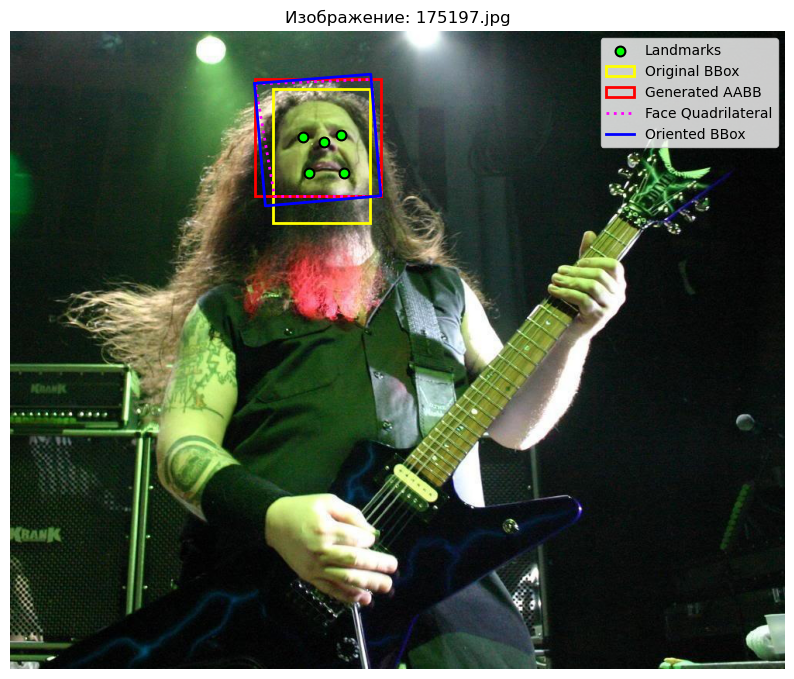

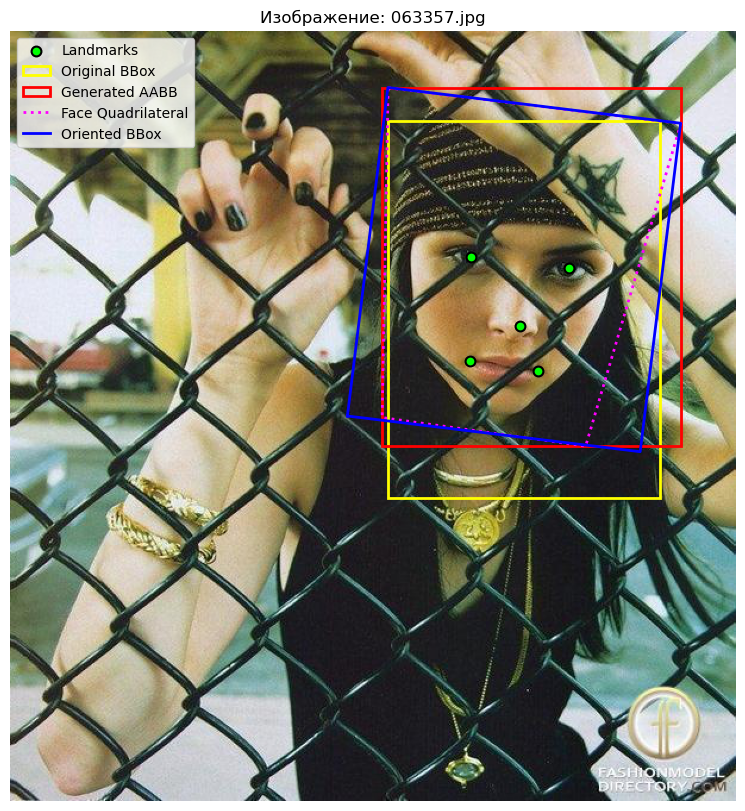

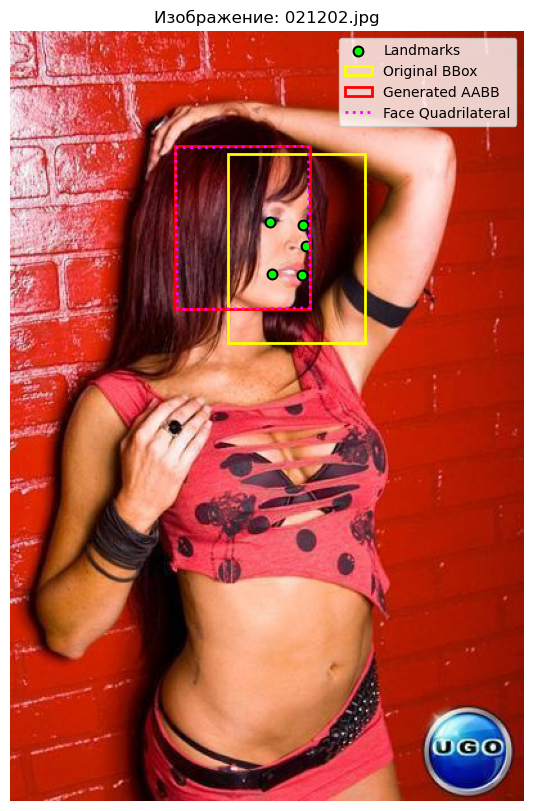

Завершена визуализация примеров изображений с ориентированными ограничивающими рамками.


In [ ]:
print("Визуализация изображений, где CompreFace не смог обнаружить лица, сравнение оригинальных, сгенерированных на основе ориентиров и ориентированных ограничивающих рамок...")

# Выбираем до 25 случайных изображений из images_without_bbox_filenames для визуализации
num_sample_images = min(25, len(images_without_bbox_filenames))
np.random.seed(42) # для воспроизводимости
sample_no_bbox_filenames = np.random.choice(images_without_bbox_filenames, num_sample_images, replace=False)

for img_filename in sample_no_bbox_filenames:
    img_file_path = path_by_image_name(img_filename)

    if img_file_path:
        try:
            img = Image.open(img_file_path)
            image_width, image_height = img.size
        except FileNotFoundError:
            print(f"Предупреждение: Изображение не найдено по адресу {img_file_path}. Пропускаем визуализацию.")
            continue

        # Получаем данные оригинального bbox для этого изображения
        original_bbox_row = bbox_df[bbox_df['image_id'] == img_filename].iloc[0]

        # Получаем данные ориентиров для этого изображения
        landmark_row = landmarks_df[landmarks_df['image_id'] == img_filename].iloc[0]

        # Генерируем ограничивающий прямоугольник, четырехугольник лица и ориентированный bbox из ориентиров
        generated_bbox, face_quad, oriented_bbox_corners = generate_bbox_from_landmarks(landmark_row, image_width, image_height)

        # Отображаем изображение с обоими ограничивающими прямоугольниками, четырехугольником лица и ориентированным bbox
        plot_image_with_multiple_bboxes(img_file_path, landmark_row, original_bbox_row, generated_bbox,
                                        face_quad_vertices=face_quad, oriented_bbox_corners=oriented_bbox_corners)
    else:
        print(f"Предупреждение: Файл изображения не найден для {img_filename}. Пропускаем визуализацию.")

print("Завершена визуализация примеров изображений с ориентированными ограничивающими рамками.")

Наши рамки, конечно, тоже не идеальны, но в большинстве случаев лучше захватывают лицо, чем оригинальные. Поэтому заменим незадетектированные рамки на сгенерированные из лэндмарков.

## Генерация рамок для незамеченных лиц

Для пропущенных моделью лиц сгенерируем рамки из лэндмарков

In [ ]:
output_better_csv_path = './celeba_dataset/list_bbox_celeba_better.csv'


In [ ]:
if not os.path.exists(output_better_csv_path):
    fallback_landmarks_df = landmarks_df[landmarks_df['image_id'].isin(images_without_bbox_filenames)]
    print(f"Filtered landmarks for fallback: {len(fallback_landmarks_df)} images.")

Filtered landmarks for fallback: 1769 images.


In [ ]:
from tqdm.auto import tqdm
if not os.path.exists(output_better_csv_path):

    fallback_detected_bboxes = []

    print(f"Generating fallback bounding boxes for {len(fallback_landmarks_df)} images...")

    for index, row in tqdm(fallback_landmarks_df.iterrows(), total=len(fallback_landmarks_df)):
        img_filename = row['image_id']
        img_file_path = path_by_image_name(img_filename)

        if img_file_path:
            try:
                img = Image.open(img_file_path)
                image_width, image_height = img.size

                generated_bbox, _, _ = generate_bbox_from_landmarks(row, image_width, image_height)

                if generated_bbox:
                    x_1, y_1, width, height = generated_bbox
                    fallback_detected_bboxes.append({
                        'image_id': img_filename,
                        'x_1': x_1,
                        'y_1': y_1,
                        'width': width,
                        'height': height
                    })
                else:
                    print(f"Warning: generate_bbox_from_landmarks returned None for {img_filename}. Skipping.")
            except FileNotFoundError:
                print(f"Warning: Image not found at {img_file_path}. Skipping bbox generation for this image.")
            except Exception as e:
                print(f"Error processing image {img_filename} for fallback bbox generation: {e}")
        else:
            print(f"Warning: Full path not found for image {img_filename}. Skipping fallback bbox generation.")

    print(f"Finished generating fallback bounding boxes. Total generated: {len(fallback_detected_bboxes)}.")

Generating fallback bounding boxes for 1769 images...


  0%|          | 0/1769 [00:00<?, ?it/s]

Finished generating fallback bounding boxes. Total generated: 1769.


In [ ]:
if not os.path.exists(output_better_csv_path):
    fallback_bbox_df = pd.DataFrame(fallback_detected_bboxes)

    final_bbox_df = pd.concat([compreface_bbox_df, fallback_bbox_df], ignore_index=True)

    final_bbox_df.to_csv(output_better_csv_path, index=False)

    print(f"Combined bounding boxes saved to {output_better_csv_path}")
    print(f"Total bounding boxes in final dataset: {len(final_bbox_df)}")
    print("First 5 rows of the combined bounding box DataFrame:")
else:
    final_bbox_df = pd.read_csv(output_better_csv_path)

print(final_bbox_df.head())

     image_id  x_1  y_1  width  height
0  125988.jpg   58   11    120     142
1  121488.jpg   64  105    217     228
2  126614.jpg   23   94    285     292
3  126917.jpg  101   93    130     128
4  120809.jpg  102   46    147     181


Визуализируем теперь случайные изображения с финальными рамками, оригинальными и лэндмарками

Visualizing 5 random images...


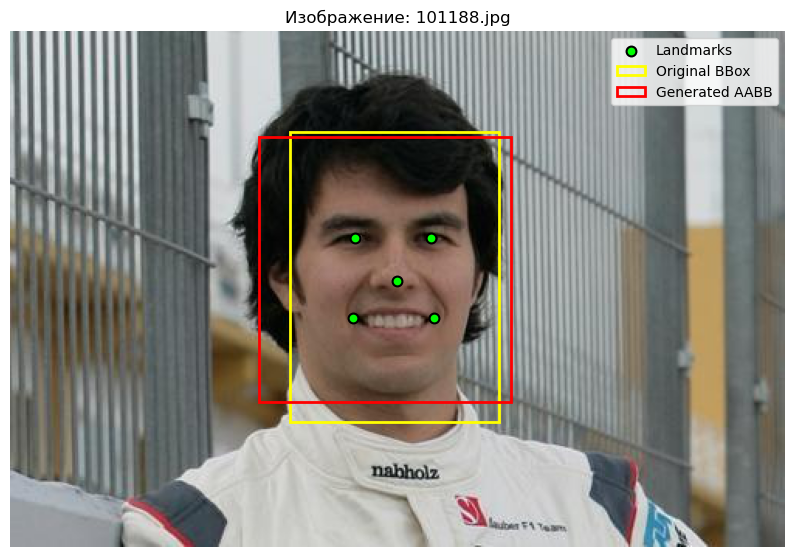

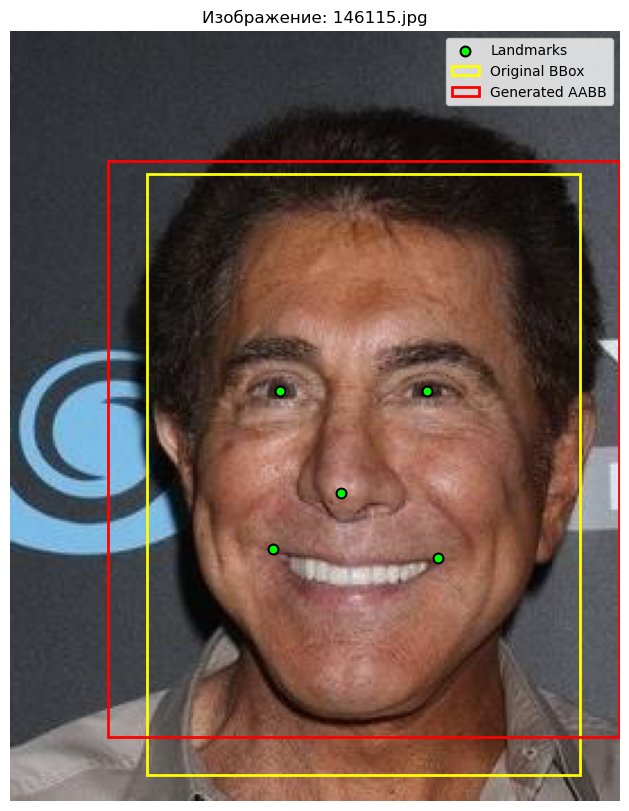

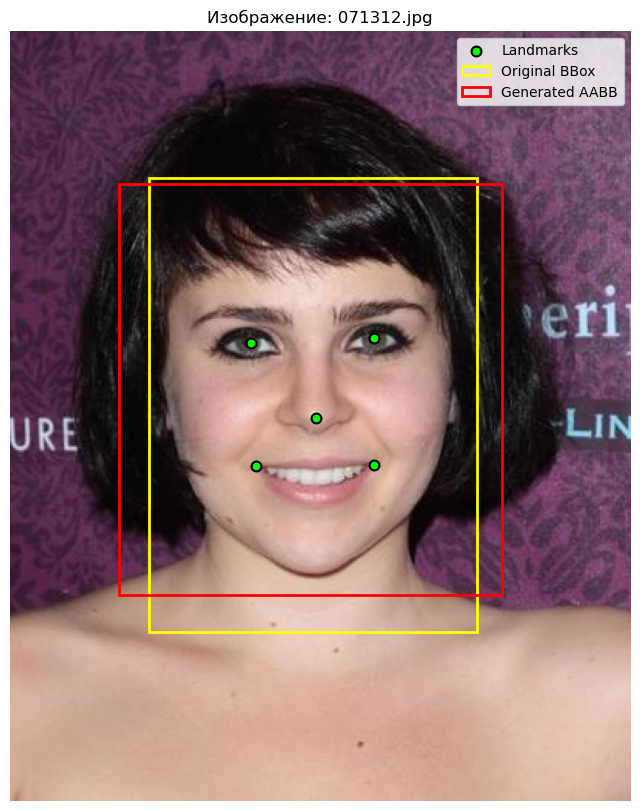

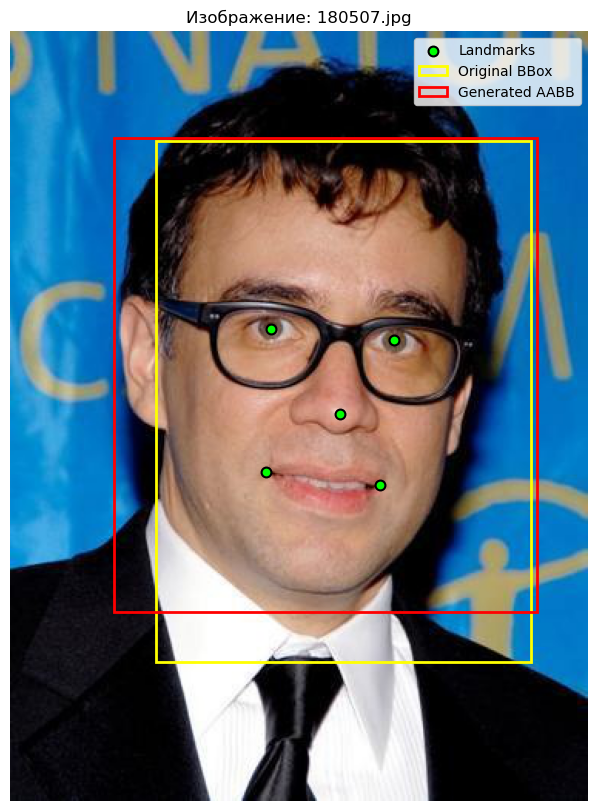

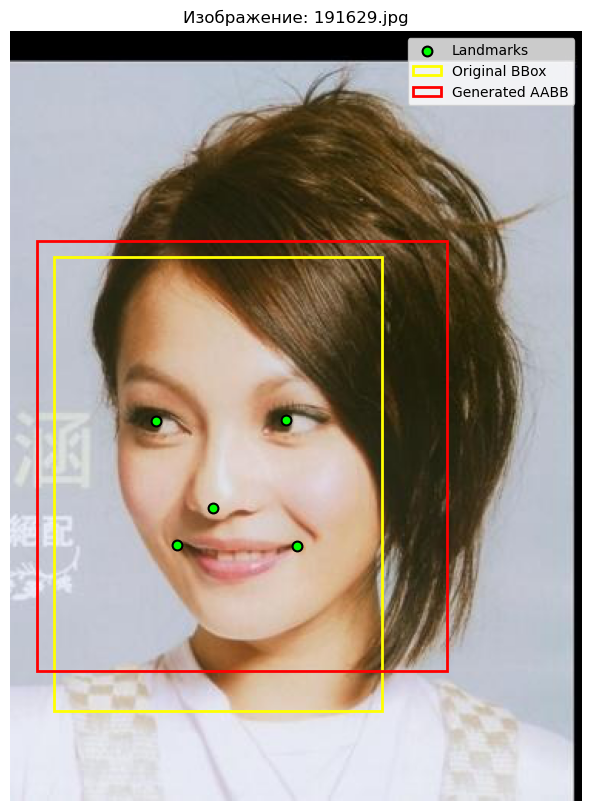

Finished visualizing random images.


In [ ]:
# Визуализируем несколько изображений с рамками и разметкой
np.random.seed(65) # for reproducibility
# Ensure there are enough images to select from
if len(image_files) >= 5:
    random_images = np.random.choice(image_files, 5, replace=False)
else:
    print(f"Warning: Only {len(image_files)} images found. Visualizing all available images.")
    random_images = image_files

if len(random_images) > 0:
    print(f"Visualizing {len(random_images)} random images...")
    for img_file_path in random_images:
        # Extract the image filename (e.g., '000001.jpg') to match with dataframe
        img_filename = os.path.basename(img_file_path)

        # Retrieve landmarks for the current image
        landmarks_row = landmarks_df[landmarks_df['image_id'] == img_filename]

        # Retrieve CompreFace bbox for the current image
        final_bbox_row = final_bbox_df[final_bbox_df['image_id'] == img_filename]
        bbox_row = bbox_df[bbox_df['image_id'] == img_filename]

        # Check if both landmarks and CompreFace bbox are available
        if not final_bbox_row.empty and not landmarks_row.empty:
            # Extract the individual bbox components from the DataFrame row
            gen_x = final_bbox_row.iloc[0]['x_1']
            gen_y = final_bbox_row.iloc[0]['y_1']
            gen_w = final_bbox_row.iloc[0]['width']
            gen_h = final_bbox_row.iloc[0]['height']

            plot_image_with_multiple_bboxes(
                img_file_path,
                landmarks_row.iloc[0],
                bbox_row.iloc[0], #original bbox (yellow)
                generated_bbox_data=(gen_x, gen_y, gen_w, gen_h) # CompreFace bbox (red)
            )
        else:
            print(f"Warning: CompreFace bounding box or landmark data not found for {img_filename}. Skipping.")

    print("Finished visualizing random images.")
else:
    print("No images to visualize.")

Теперь выберем 10000 изображений, с как можно более равномерным распределением атрибутов

# Равномерная выборка изображений
На основе атрибутов изображений разобъем множество изображений на 200 кластеров (KMeans). Затем выберем в наш датасет равное количество примеров из всех кластеров, чтобы убрать возможный дисбаланс и обеспечить достаточное обучение сети даже на редких позах.

In [ ]:
attributes_path = source_dir + '/list_attr_celeba.csv'
attrs_df = pd.read_csv(attributes_path)

print("Original attributes DataFrame head:")
display(attrs_df.head())
print(f"Original attributes DataFrame shape: {attrs_df.shape}")

work_attrs_df = attrs_df.copy()


Original attributes DataFrame head:


,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,-1,1,1,-1,-1,-1,-1,-1,-1,...,-1,1,1,-1,1,-1,1,-1,-1,1
1,000002.jpg,-1,-1,-1,1,-1,-1,-1,1,-1,...,-1,1,-1,-1,-1,-1,-1,-1,-1,1
2,000003.jpg,-1,-1,-1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,1
3,000004.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,-1,1,-1,1,1,-1,1
4,000005.jpg,-1,1,1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,-1,-1,-1,1,-1,-1,1


Original attributes DataFrame shape: (202599, 41)


In [ ]:
attribute_columns = work_attrs_df.columns.drop('image_id')

# Приведем все значения к 0 - 1
work_attrs_df.loc[:, attribute_columns] = work_attrs_df.loc[:, attribute_columns].replace({-1: 0, 1: 1})

print("Attributes DataFrame with values converted from -1/1 to 0/1 (first 5 rows):")
display(work_attrs_df.head())
print(f"Updated attributes DataFrame shape: {work_attrs_df.shape}")

Attributes DataFrame with values converted from -1/1 to 0/1 (first 5 rows):


,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,0,1,1,0,1,0,1,0,0,1
1,000002.jpg,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,1
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,0,1,0,1,0,1,1,0,1
4,000005.jpg,0,1,1,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,1


Updated attributes DataFrame shape: (202599, 41)


Готовим данные к кластеризации


In [ ]:
X_attributes = work_attrs_df.drop(columns=['image_id']).copy()

print("Feature matrix for clustering (X_attributes) head:")
display(X_attributes.head())
print(f"Feature matrix shape: {X_attributes.shape}")

Feature matrix for clustering (X_attributes) head:


,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,Blond_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,0,1,1,0,0,0,0,0,0,0,...,0,1,1,0,1,0,1,0,0,1
1,0,0,0,1,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,1
2,0,0,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,0,0,0,1
3,0,0,1,0,0,0,0,0,0,0,...,0,0,1,0,1,0,1,1,0,1
4,0,1,1,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,1


Feature matrix shape: (202599, 40)


Кластеризуем

K-means clustering applied with 200 clusters.
First 5 rows of attrs_df with new 'cluster' column:


,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young,cluster
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,1,1,0,1,0,1,0,0,1,188
1,000002.jpg,0,0,0,1,0,0,0,1,0,...,1,0,0,0,0,0,0,0,1,31
2,000003.jpg,0,0,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,1,86
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,1,0,1,0,1,1,0,1,162
4,000005.jpg,0,1,1,0,0,0,1,0,0,...,0,0,0,0,0,1,0,0,1,166


Updated attrs_df shape: (202599, 42)


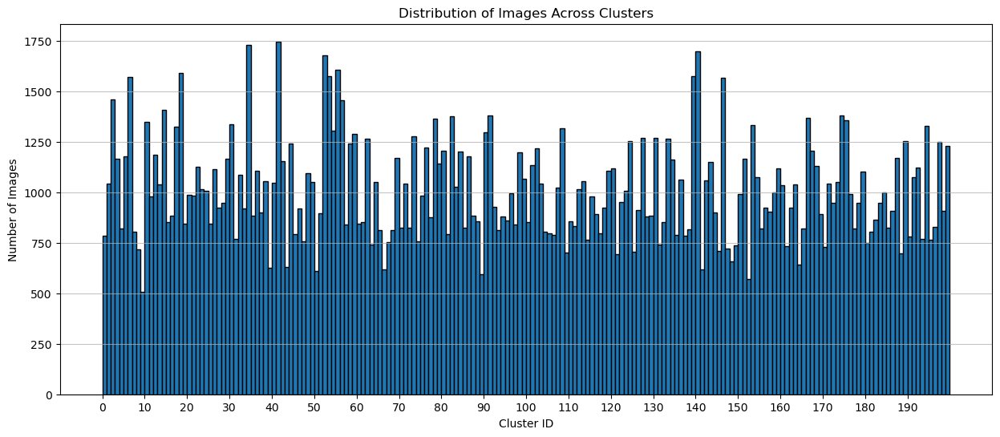

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=200, random_state=42, n_init='auto')
cluster_labels = kmeans.fit_predict(X_attributes)

work_attrs_df['cluster'] = cluster_labels

print("K-means clustering applied with 200 clusters.")
print("First 5 rows of attrs_df with new 'cluster' column:")
display(work_attrs_df.head())
print(f"Updated attrs_df shape: {work_attrs_df.shape}")

plt.figure(figsize=(15, 6))
plt.hist(work_attrs_df['cluster'], bins=range(0, kmeans.n_clusters + 1), edgecolor='black')
plt.title('Distribution of Images Across Clusters')
plt.xlabel('Cluster ID')
plt.ylabel('Number of Images')
plt.xticks(range(0, kmeans.n_clusters, 10)) # Show every 10th cluster ID for readability
plt.grid(axis='y', alpha=0.75)
plt.show()

Судя по гистограмме, распределение примеров по кластерам более-менее, равномерное. Есть отличия в 2-3 раза. Но всё равно отберем в наш датасет равное число примеров из каждого кластера

In [ ]:
TARGET_TOTAL_SAMPLES = 20000

# Вычисляем количество изображений для равномерной выборки из каждого кластера
num_clusters = work_attrs_df['cluster'].nunique()
uniform_samples_per_cluster = int(TARGET_TOTAL_SAMPLES / num_clusters)

# Создаем Series для samples_per_cluster с равномерными значениями
samples_per_cluster = pd.Series(uniform_samples_per_cluster, index=work_attrs_df['cluster'].unique())

print("Calculated uniform samples per cluster (first 5 clusters):\n", samples_per_cluster.head())
print(f"Total calculated samples across all clusters: {samples_per_cluster.sum()}")

selected_image_ids = [] # Список для сбора image_id

for cluster_id, num_samples in samples_per_cluster.items():
    cluster_df = work_attrs_df[work_attrs_df['cluster'] == cluster_id]
    # Сэмплируем с заменой, если num_samples больше размера кластера
    if num_samples > len(cluster_df):
        sampled_ids = cluster_df['image_id'].sample(n=num_samples, replace=True, random_state=42)
    else:
        sampled_ids = cluster_df['image_id'].sample(n=num_samples, replace=False, random_state=42)
    selected_image_ids.extend(sampled_ids.tolist()) # Добавляем image_id в общий список

# Теперь фильтруем оригинальный attrs_df по собранным image_id
selected_images_df = attrs_df[attrs_df['image_id'].isin(selected_image_ids)]

print(f"Total selected images: {len(selected_images_df)}")
print("First 5 rows of selected_images_df:")
display(selected_images_df.sample(5))


Calculated uniform samples per cluster (first 5 clusters):
 188    100
31     100
86     100
162    100
166    100
dtype: int64
Total calculated samples across all clusters: 20000
Total selected images: 20000
First 5 rows of selected_images_df:


,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
73124,073125.jpg,-1,1,1,-1,-1,-1,-1,-1,1,...,-1,1,1,-1,1,-1,1,-1,-1,1
122950,122951.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,...,-1,1,-1,1,1,-1,1,-1,-1,1
111672,111673.jpg,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,-1,-1,-1,-1,-1,-1,-1
199050,199051.jpg,-1,-1,1,-1,-1,-1,-1,-1,1,...,-1,1,-1,1,1,-1,1,-1,-1,1
142348,142349.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,...,-1,1,-1,1,-1,-1,1,-1,-1,1


Теперь кропнем и сохраним наш датасет в отдельной папке `./celeba_dataset/sm/`

In [ ]:
selected_image_ids_set = set(selected_images_df['image_id'])

filtered_bbox_df = final_bbox_df[final_bbox_df['image_id'].isin(selected_image_ids_set)].copy()
filtered_landmarks_df = landmarks_df[landmarks_df['image_id'].isin(selected_image_ids_set)].copy()

print(f"Number of images in selected_images_df: {len(selected_image_ids_set)}")
print(f"Number of bounding boxes in filtered_bbox_df: {len(filtered_bbox_df)}")
print(f"Number of landmarks in filtered_landmarks_df: {len(filtered_landmarks_df)}")

print("Filtered Bounding Box DataFrame head:")
display(filtered_bbox_df.head())
print("Filtered Landmarks DataFrame head:")
display(filtered_landmarks_df.head())

Number of images in selected_images_df: 20000
Number of bounding boxes in filtered_bbox_df: 20000
Number of landmarks in filtered_landmarks_df: 20000
Filtered Bounding Box DataFrame head:


,image_id,x_1,y_1,width,height
0,125988.jpg,58,11,120,142
9,120961.jpg,0,54,296,347
29,129510.jpg,210,282,456,476
36,124350.jpg,279,103,161,178
40,125119.jpg,127,66,105,119


Filtered Landmarks DataFrame head:


,image_id,lefteye_x,lefteye_y,righteye_x,righteye_y,nose_x,nose_y,leftmouth_x,leftmouth_y,rightmouth_x,rightmouth_y
126,000127.jpg,85,54,109,53,96,69,89,78,108,78
159,000160.jpg,237,170,297,180,258,220,231,236,281,244
185,000186.jpg,156,143,197,138,164,170,160,190,196,190
247,000248.jpg,193,103,222,100,210,116,200,137,225,134
269,000270.jpg,129,126,191,138,148,168,115,181,180,197


In [ ]:
import os

output_dir_images = './celeba_dataset/sm/images'
output_dir = './celeba_dataset/sm'
os.makedirs(output_dir_images, exist_ok=True)
print(f"Directory '{output_dir_images}' ensured to exist.")

Directory './celeba_dataset/sm/images' ensured to exist.


Пройдемся по изображениям в цикле, кропнем их и обновим лэндмарки


In [ ]:
from PIL import Image
import os

cropped_landmarks = []

print(f"Processing and cropping {len(selected_images_df)} images...")

for index, row in tqdm(selected_images_df.iterrows(), total=len(selected_images_df)):
    image_id = row['image_id']
    original_image_path = path_by_image_name(image_id)

    if original_image_path:
        try:
            img = Image.open(original_image_path)

            # Извлекаем ограничивающую рамку для текущего изображения
            bbox_row = filtered_bbox_df[filtered_bbox_df['image_id'] == image_id]
            if not bbox_row.empty:
                x_1, y_1, width, height = bbox_row.iloc[0][['x_1', 'y_1', 'width', 'height']]

                # Обрезаем изображение
                # Image.crop принимает кортеж из 4 значений (left, upper, right, lower)
                cropped_img = img.crop((x_1, y_1, x_1 + width, y_1 + height))

                # Сохраняем обрезанное изображение
                cropped_image_path = os.path.join(output_dir_images, image_id)
                cropped_img.save(cropped_image_path)

                # Извлекаем и преобразуем данные ключевых точек
                landmark_data = filtered_landmarks_df[filtered_landmarks_df['image_id'] == image_id].iloc[0].copy()
                translated_landmarks = {'image_id': image_id}
                for col_name in landmark_data.index:
                    if '_x' in col_name:
                        translated_landmarks[col_name] = landmark_data[col_name] - x_1
                    elif '_y' in col_name:
                        translated_landmarks[col_name] = landmark_data[col_name] - y_1

                cropped_landmarks.append(translated_landmarks)
            else:
                print(f"Warning: Bounding box data not found for {image_id}. Skipping.")
        except FileNotFoundError:
            print(f"Warning: Original image not found at {original_image_path}. Skipping.")
        except Exception as e:
            print(f"Error processing image {image_id}: {e}. Skipping.")
    else:
        print(f"Warning: Full path for image {image_id} not found. Skipping.")

print(f"Finished cropping and translating landmarks for {len(cropped_landmarks)} images.")

Processing and cropping 20000 images...


  0%|          | 0/20000 [00:00<?, ?it/s]

Finished cropping and translating landmarks for 20000 images.


In [ ]:
import pandas as pd
import os

# Сохраняем selected_images_df
selected_attributes_path = os.path.join(output_dir, 'selected_attributes.csv')
selected_images_df.to_csv(selected_attributes_path, index=False)
print(f"'selected_attributes.csv' сохранено в {selected_attributes_path}")

# Преобразуем cropped_landmarks в DataFrame и сохраняем
cropped_landmarks_df = pd.DataFrame(cropped_landmarks)
translated_landmarks_path = os.path.join(output_dir, 'translated_landmarks.csv')
cropped_landmarks_df.to_csv(translated_landmarks_path, index=False)
print(f"'translated_landmarks.csv' сохранено в {translated_landmarks_path}")

'selected_attributes.csv' сохранено в ./celeba_dataset/sm/selected_attributes.csv
'translated_landmarks.csv' сохранено в ./celeba_dataset/sm/translated_landmarks.csv


А теперь визуализируем сэмплы из нашего нового датасета

Визуализируем 5 случайных сэмплов из нового, кропнутого датасета с разметкой...


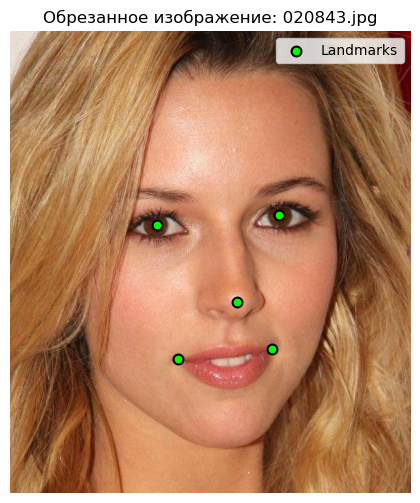

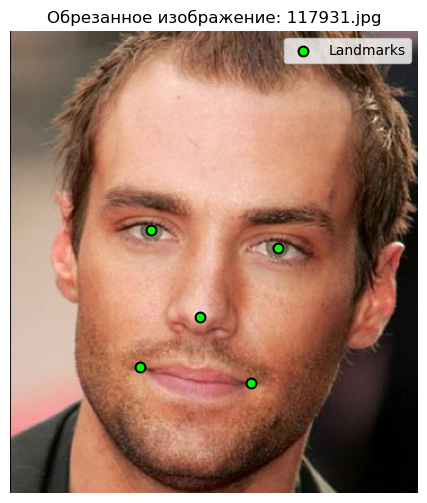

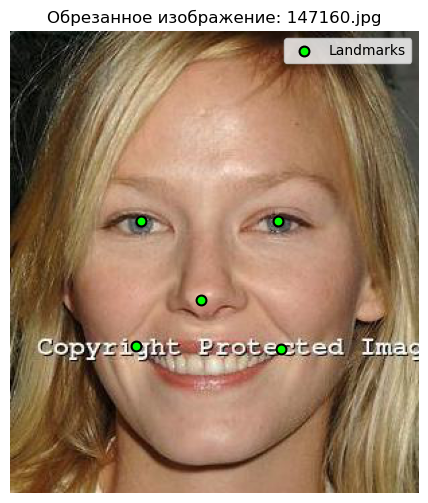

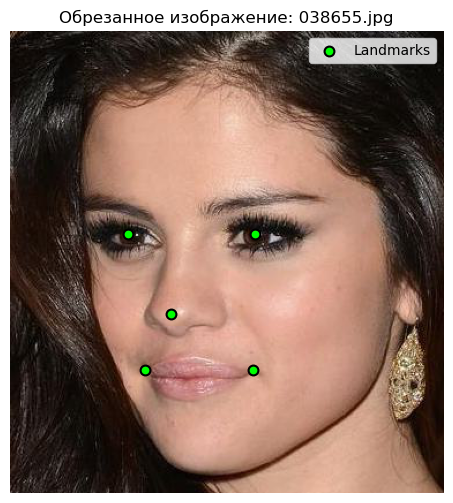

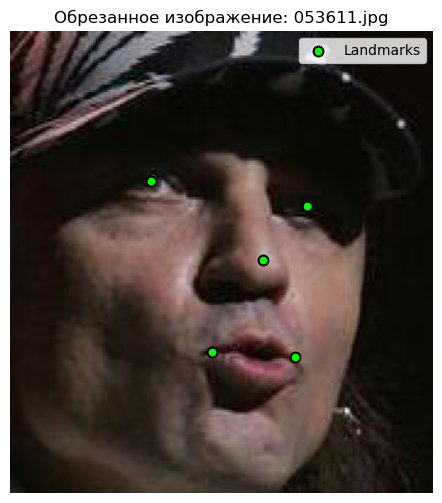

Визуализация завершена.


In [ ]:
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
import pandas as pd

def plot_cropped_face_with_landmarks(image_path, landmark_data, landmark_color='lime', landmark_marker='o'):
    """
    Отображает обрезанное изображение с опорными точками.

    :param image_path: Путь к файлу обрезанного изображения.
    :param landmark_data: Объект pandas Series или словарь, содержащий координаты опорных точек.
    :param landmark_color: Цвет для опорных точек.
    :param landmark_marker: Стиль маркера для опорных точек.
    """
    try:
        img = Image.open(image_path)
    except FileNotFoundError:
        print(f"Предупреждение: Обрезанное изображение не найдено по адресу {image_path}. Пропускаем.")
        return

    fig, ax = plt.subplots(1, figsize=(6, 6)) # Меньший размер для обрезанных лиц
    ax.imshow(img)

    # Отображаем опорные точки
    landmark_cols_x = [col for col in landmark_data.index if '_x' in col]
    landmark_cols_y = [col for col in landmark_data.index if '_y' in col]
    landmarks_x = [landmark_data[col] for col in landmark_cols_x]
    landmarks_y = [landmark_data[col] for col in landmark_cols_y]
    ax.scatter(landmarks_x, landmarks_y, color=landmark_color, s=50, marker=landmark_marker, edgecolors='black', linewidths=1.5, label='Landmarks')

    ax.set_title(f"Обрезанное изображение: {os.path.basename(image_path)}")
    ax.axis('off')
    ax.legend()
    plt.show()

# Выбираем 5 случайных изображений
np.random.seed(65) # для воспроизводимости
random_selected_images = selected_images_df.sample(5, random_state=65)

print("Визуализируем 5 случайных сэмплов из нового, кропнутого датасета с разметкой...")

for index, row in random_selected_images.iterrows():
    image_id = row['image_id']
    cropped_img_path = os.path.join(output_dir_images, image_id)

    # Получаем переведенные лэндмарки для этого image_id
    current_landmarks = cropped_landmarks_df[cropped_landmarks_df['image_id'] == image_id]

    if not current_landmarks.empty:
        plot_cropped_face_with_landmarks(cropped_img_path, current_landmarks.iloc[0])
    else:
        print(f"Предупреждение: Лэндмарки для изображения {image_id} не найдены в cropped_landmarks_df. Пропускаем.")

print("Визуализация завершена.")